- 1) Installation des dépendances
- 2) Chargement et prétraitement des données
- 3) Générateur de données personnalisé (Sequence)
- 4) Création des modèles de segmentation (U-Net)
- 5) Définition des fonctions de perte et des métriques
- 6) Entraînement des modèles
- 7) Visualisation des résultats d'entraînement
- 8) Évaluation des modèles sur les données de test

# 1) Installation des dépendances

In [ ]:
!pip install tensorflow opencv-python matplotlib scikit-learn albumentations

In [ ]:
import os
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
from tensorflow.keras.preprocessing.image import load_img, img_to_array
import matplotlib.pyplot as plt
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Input, Conv2D, MaxPooling2D, UpSampling2D, concatenate, Activation, Conv2DTranspose
from tensorflow.keras.optimizers import Adam
import cv2
from sklearn.model_selection import train_test_split
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import json
from PIL import Image, ImageDraw
from tensorflow.keras.utils import Sequence
import albumentations as A
from sklearn.metrics import jaccard_score, f1_score
from tensorflow.keras.callbacks import EarlyStopping, ModelCheckpoint
from tensorflow.keras import backend as K
from tensorflow.keras.applications import VGG16

/usr/local/lib/python3.11/dist-packages/albumentations/__init__.py:28: UserWarning: A new version of Albumentations is available: '2.0.5' (you have '2.0.4'). Upgrade using: pip install -U albumentations. To disable automatic update checks, set the environment variable NO_ALBUMENTATIONS_UPDATE to 1.
  check_for_updates()


In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# 2) Chargement et prétraitement des données

In [ ]:
# Définition des 8 catégories principales
CATEGORY_MAPPING = {
    0: 0,  # road
    1: 0,  # sidewalk
    2: 1,  # building
    3: 2,  # wall
    4: 3,  # fence
    5: 4,  # pole
    6: 5,  # traffic light
    7: 5,  # traffic sign
    8: 6,  # vegetation
    9: 7,  # terrain
    10: 1, # sky
    11: 1, # person
    12: 2, # rider
    13: 2, # car
    14: 2, # truck
    15: 2, # bus
    16: 2, # train
    17: 2, # motorcycle
    18: 2, # bicycle
    -1: 7  # unlabelled
}

In [ ]:
# Fonction pour charger les images et les masques et convertir les classes
def load_images_and_masks(base_directory, target_size=(256, 256)):
  """
    Charge les images et les masques à partir d'un répertoire, les redimensionne et convertit les classes.

    Args:
        base_directory (str): Le chemin du répertoire contenant les données.
        target_size (tuple): La taille cible des images et des masques.

    Returns:
        tuple: Un tuple contenant deux tableaux NumPy : les images et les masques.
    """
    images = []
    masks = []
    image_count = 0
    mask_count = 0

    for city in os.listdir(base_directory):
        city_path = os.path.join(base_directory, city)
        if os.path.isdir(city_path):
            print(f"Processing city: {city}")

            for filename in os.listdir(city_path):
                if filename.endswith("_leftImg8bit.png"):
                    # Charger l'image
                    img_path = os.path.join(city_path, filename)
                    mask_filename = filename.replace("_leftImg8bit.png", "_gtFine_labelIds.png")
                    mask_path = os.path.join(city_path, mask_filename)

                    if os.path.exists(img_path) and os.path.exists(mask_path):
                        try:
                            img = load_img(img_path, target_size=target_size)
                            img = img_to_array(img) / 255.0
                            images.append(img)
                            image_count += 1

                            # Charger le masque et convertir les classes
                            mask = load_img(mask_path, target_size=target_size, color_mode='grayscale')
                            mask = img_to_array(mask)
                            mask = convert_classes(mask, CATEGORY_MAPPING)
                            masks.append(mask)
                            mask_count += 1
                        except Exception as e:
                            print(f"Error loading image or creating mask: {e}")
                    else:
                        print(f"Image or mask not found: {img_path}")

    print(f"Total images loaded: {image_count}")
    print(f"Total masks created: {mask_count}")
    return np.array(images), np.array(masks)

In [ ]:
# Fonction pour convertir les 34 classes en 8 catégories
def convert_classes(mask, mapping):
  """
    Convertit les classes d'un masque en utilisant un mappage donné.

    Args:
        mask (numpy.ndarray): Le masque à convertir.
        mapping (dict): Le mappage des classes (ancien -> nouveau).

    Returns:
        numpy.ndarray: Le masque converti.
    """
    temp = np.zeros_like(mask, dtype=np.uint8)
    for k, v in mapping.items():
        temp[mask == k] = v
    return temp

In [ ]:
# Charger les données
train_images, train_masks = load_images_and_masks('/content/drive/My Drive/ColabNotebooks/8.TraiterImagesSysteme/gtFine/train')
val_images, val_masks = load_images_and_masks('/content/drive/My Drive/ColabNotebooks/8.TraiterImagesSysteme/gtFine/val')

Processing city: aachen
Processing city: jena
Processing city: monchengladbach
Processing city: hamburg
Processing city: bochum
Processing city: cologne
Processing city: dusseldorf
Processing city: darmstadt
Processing city: krefeld
Processing city: hanover
Processing city: erfurt
Processing city: bremen
Processing city: zurich
Processing city: weimar
Total images loaded: 2175
Total masks created: 2175
Processing city: frankfurt
Processing city: lindau
Processing city: munster
Total images loaded: 500
Total masks created: 500


In [ ]:
# Afficher le nombre d'images chargées
print(f"Train images: {len(train_images)}, Train masks: {len(train_masks)}")
print(f"Val images: {len(val_images)}, Val masks: {len(val_masks)}")

Train images: 2175, Train masks: 2175
Val images: 500, Val masks: 500


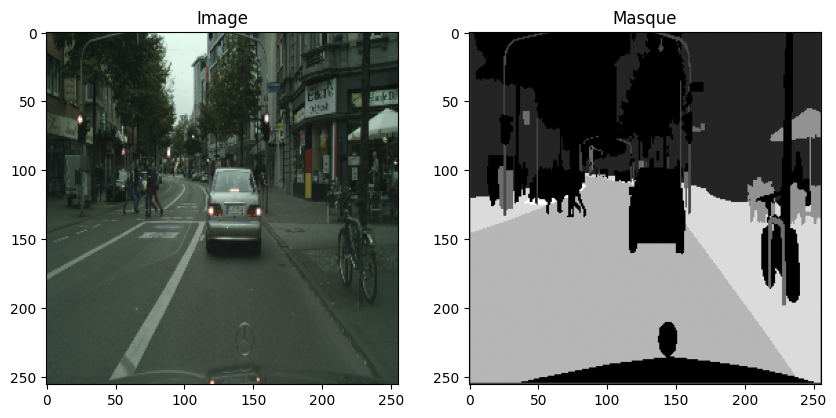

In [ ]:
# Afficher un échantillon d'images et de masques
plt.figure(figsize=(10, 5))
plt.subplot(1, 2, 1)
plt.title("Image")
plt.imshow(train_images[0])
plt.subplot(1, 2, 2)
plt.title("Masque")
plt.imshow(train_masks[0,:,:,0], cmap="gray")
plt.show()

# 3) Générateur de données personnalisé (Sequence)

In [ ]:
class DataGenerator(Sequence):
  """
    Générateur de données personnalisé pour l'entraînement.

    Args:
        images (numpy.ndarray): Tableau des images.
        masks (numpy.ndarray): Tableau des masques.
        batch_size (int): Taille du lot.
        img_size (tuple): Taille des images.
        augment (bool): Indique si l'augmentation des données doit être appliquée.
    """
    def __init__(self, images, masks, batch_size=32, img_size=(256, 256), augment=True):
        self.images = images
        self.masks = masks
        self.batch_size = batch_size
        self.img_size = img_size
        self.augment = augment

        self.aug = A.Compose([
            A.HorizontalFlip(p=0.5),
            A.RandomBrightnessContrast(p=0.2),
            A.RandomRotate90(p=0.2),
            A.Resize(height=self.img_size[0], width=self.img_size[1], always_apply=True)
        ])

    def __len__(self):
    """Retourne le nombre de lots par époque."""
        return int(np.ceil(len(self.images) / float(self.batch_size)))

    def __getitem__(self, idx):
      """Retourne un lot d'images et de masques."""
        batch_images = self.images[idx * self.batch_size:(idx + 1) * self.batch_size]
        batch_masks = self.masks[idx * self.batch_size:(idx + 1) * self.batch_size]

        batch_images_aug = []
        batch_masks_aug = []

        for i in range(len(batch_images)):
            img = batch_images[i]
            mask = batch_masks[i]

            if self.augment:
                augmented = self.aug(image=img, mask=mask)
                img = augmented['image']
                mask = augmented['mask']
            else:
                img = A.Resize(height=self.img_size[0], width=self.img_size[1], channel_first=False)(image=img)['image']
                mask = A.Resize(height=self.img_size[0], width=self.img_size[1], channel_first=False)(image=mask)['image']

            batch_images_aug.append(img)
            batch_masks_aug.append(mask)

        batch_images_aug = np.array(batch_images_aug)
        batch_masks_aug = np.array(batch_masks_aug).astype('float32')

        return batch_images_aug, batch_masks_aug

In [ ]:
# Initialisation des générateurs
batch_size = 8
train_generator = DataGenerator(train_images, train_masks, batch_size, augment=True)
val_generator = DataGenerator(val_images, val_masks, batch_size, augment=False)

<ipython-input-12-0568b722ac27>:13: UserWarning: Argument(s) 'always_apply' are not valid for transform Resize
  A.Resize(height=self.img_size[0], width=self.img_size[1], always_apply=True)


# 4) Création des modèles de segmentation (U-Net)

In [ ]:
# U-Net Mini
def unet_mini(input_size=(256, 256, 3), num_classes=8):
  """
    Crée un modèle U-Net Mini pour la segmentation sémantique.

    Args:
        input_size (tuple): La taille de l'entrée du modèle.
        num_classes (int): Le nombre de classes de segmentation.

    Returns:
        tensorflow.keras.models.Model: Le modèle U-Net Mini.
    """
    inputs = Input(input_size)

    # Encoder
    conv1 = Conv2D(32, 3, activation='relu', padding='same')(inputs)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)

    conv2 = Conv2D(64, 3, activation='relu', padding='same')(pool1)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)

    # Bottleneck
    conv3 = Conv2D(128, 3, activation='relu', padding='same')(pool2)

    # Decoder
    up1 = UpSampling2D(size=(2, 2))(conv3)
    concat1 = concatenate([conv2, up1], axis=-1)
    conv4 = Conv2D(64, 3, activation='relu', padding='same')(concat1)

    up2 = UpSampling2D(size=(2, 2))(conv4)
    concat2 = concatenate([conv1, up2], axis=-1)
    conv5 = Conv2D(32, 3, activation='relu', padding='same')(concat2)

    # Output
    outputs = Conv2D(num_classes, 1, activation='softmax')(conv5)

    model = Model(inputs, outputs)
    return model

In [ ]:
# VGG16 U-Net
def vgg16_unet(input_size=(256, 256, 3), num_classes=8):
  """
    Crée un modèle U-Net basé sur VGG16 pour la segmentation sémantique.

    Args:
        input_size (tuple): La taille de l'entrée du modèle.
        num_classes (int): Le nombre de classes de segmentation.

    Returns:
        tensorflow.keras.models.Model: Le modèle U-Net basé sur VGG16.
    """
    # Encoder (VGG16)
    vgg16 = VGG16(include_top=False, weights='imagenet', input_tensor=Input(shape=input_size))

    # Decoder
    x = Conv2D(512, 3, activation='relu', padding='same')(vgg16.output)
    x = Conv2D(512, 3, activation='relu', padding='same')(x)
    x = Conv2DTranspose(512, 3, strides=2, padding='same')(x)

    x = Conv2DTranspose(512, 3, strides=2, padding='same')(x)
    x = concatenate([x, vgg16.get_layer("block4_conv3").output])
    x = Conv2D(512, 3, activation='relu', padding='same')(x)
    x = Conv2D(512, 3, activation='relu', padding='same')(x)

    x = Conv2DTranspose(256, 3, strides=2, padding='same')(x)
    x = concatenate([x, vgg16.get_layer("block3_conv3").output])
    x = Conv2D(256, 3, activation='relu', padding='same')(x)
    x = Conv2D(256, 3, activation='relu', padding='same')(x)

    x = Conv2DTranspose(128, 3, strides=2, padding='same')(x)
    x = concatenate([x, vgg16.get_layer("block2_conv2").output])
    x = Conv2D(128, 3, activation='relu', padding='same')(x)
    x = Conv2D(128, 3, activation='relu', padding='same')(x)

    x = Conv2DTranspose(64, 3, strides=2, padding='same')(x)
    x = concatenate([x, vgg16.get_layer("block1_conv2").output])
    x = Conv2D(64, 3, activation='relu', padding='same')(x)
    x = Conv2D(64, 3, activation='relu', padding='same')(x)

    outputs = Conv2D(num_classes, 1, activation='softmax')(x)

    model = Model(inputs=vgg16.input, outputs=outputs)
    return model



In [ ]:
# Initialisation des modèles
model_mini = unet_mini(num_classes=8)
model_vgg16 = vgg16_unet(num_classes=8)

58889256/58889256 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


# 5) Définition des fonctions de perte et des métriques

In [ ]:
# Dice Loss
import tensorflow.keras.backend as K
def sparse_dice_coef(y_true, y_pred, num_classes=8, smooth=1):
  """
    Calcule le coefficient de Dice.

    Args:
        y_true (tensorflow.Tensor): Les masques réels.
        y_pred (tensorflow.Tensor): Les masques prédits.
        smooth (float): Un terme de lissage pour éviter la division par zéro.

    Returns:
        tensorflow.Tensor: Le coefficient de Dice.
    """
    y_true_f = K.flatten(K.one_hot(K.cast(y_true, 'int32'), num_classes))
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)

def sparse_dice_loss(y_true, y_pred):
  """
    Calcule la perte de Dice.

    Args:
        y_true (tensorflow.Tensor): Les masques réels.
        y_pred (tensorflow.Tensor): Les masques prédits.

    Returns:
        tensorflow.Tensor: La perte de Dice.
    """
    return 1 - sparse_dice_coef(y_true, y_pred)

def sparse_iou(y_true, y_pred, num_classes=8):
  """
    Calcule l'IoU (Intersection over Union).

    Args:
        y_true (tensorflow.Tensor): Les masques réels.
        y_pred (tensorflow.Tensor): Les masques prédits.

    Returns:
        tensorflow.Tensor: L'IoU.
    """
    y_true_f = K.flatten(K.one_hot(K.cast(y_true, 'int32'), num_classes))
    y_pred_f = K.flatten(y_pred)
    intersection = K.sum(y_true_f * y_pred_f)
    union = K.sum(y_true_f) + K.sum(y_pred_f) - intersection
    return intersection / (union + K.epsilon())

# Compilation des modèles
model_mini = unet_mini(num_classes=8)
model_vgg16 = vgg16_unet(num_classes=8)

model_mini.compile(optimizer=Adam(learning_rate=1e-4),
                   loss='sparse_categorical_crossentropy',
                   metrics=['accuracy', sparse_iou, sparse_dice_coef])

model_vgg16.compile(optimizer=Adam(learning_rate=1e-4),
                    loss='sparse_categorical_crossentropy',
                    metrics=['accuracy', sparse_iou, sparse_dice_coef])

In [ ]:
model_mini.summary()
model_vgg16.summary()

Model: "functional_2"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_2             │ (None, 256, 256, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_17 (Conv2D)        │ (None, 256, 256, 32)   │            896 │ input_layer_2[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_2           │ (None, 128, 128, 32)   │              0 │ conv2d_17[0][0]        │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_18 (Conv2D)        │ (None, 128, 128, 64)   │         18,496 │ max_pooling2d_2[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ max_pooling2d_3           │ (None, 64, 64, 64)     │              0 │ conv2d_18[0][0]        │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_19 (Conv2D)        │ (None, 64, 64, 128)    │         73,856 │ max_pooling2d_3[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ up_sampling2d_2           │ (None, 128, 128, 128)  │              0 │ conv2d_19[0][0]        │
│ (UpSampling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_6             │ (None, 128, 128, 192)  │              0 │ conv2d_18[0][0],       │
│ (Concatenate)             │                        │                │ up_sampling2d_2[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_20 (Conv2D)        │ (None, 128, 128, 64)   │        110,656 │ concatenate_6[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ up_sampling2d_3           │ (None, 256, 256, 64)   │              0 │ conv2d_20[0][0]        │
│ (UpSampling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ concatenate_7             │ (None, 256, 256, 96)   │              0 │ conv2d_17[0][0],       │
│ (Concatenate)             │                        │                │ up_sampling2d_3[0][0]  │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_21 (Conv2D)        │ (None, 256, 256, 32)   │         27,680 │ concatenate_7[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2d_22 (Conv2D)        │ (None, 256, 256, 8)    │            264 │ conv2d_21[0][0]        │
└───────────────────────────┴────────────────────────┴────────────────┴────────────────────────┘

 Total params: 231,848 (905.66 KB)

 Trainable params: 231,848 (905.66 KB)

 Non-trainable params: 0 (0.00 B)

Model: "functional_3"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer_3             │ (None, 256, 256, 3)    │              0 │ -                      │
│ (InputLayer)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1_conv1 (Conv2D)     │ (None, 256, 256, 64)   │          1,792 │ input_layer_3[0][0]    │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1_conv2 (Conv2D)     │ (None, 256, 256, 64)   │         36,928 │ block1_conv1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block1_pool               │ (None, 128, 128, 64)   │              0 │ block1_conv2[0][0]     │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block2_conv1 (Conv2D)     │ (None, 128, 128, 128)  │         73,856 │ block1_pool[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block2_conv2 (Conv2D)     │ (None, 128, 128, 128)  │        147,584 │ block2_conv1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block2_pool               │ (None, 64, 64, 128)    │              0 │ block2_conv2[0][0]     │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block3_conv1 (Conv2D)     │ (None, 64, 64, 256)    │        295,168 │ block2_pool[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block3_conv2 (Conv2D)     │ (None, 64, 64, 256)    │        590,080 │ block3_conv1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block3_conv3 (Conv2D)     │ (None, 64, 64, 256)    │        590,080 │ block3_conv2[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block3_pool               │ (None, 32, 32, 256)    │              0 │ block3_conv3[0][0]     │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block4_conv1 (Conv2D)     │ (None, 32, 32, 512)    │      1,180,160 │ block3_pool[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block4_conv2 (Conv2D)     │ (None, 32, 32, 512)    │      2,359,808 │ block4_conv1[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block4_conv3 (Conv2D)     │ (None, 32, 32, 512)    │      2,359,808 │ block4_conv2[0][0]     │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block4_pool               │ (None, 16, 16, 512)    │              0 │ block4_conv3[0][0]     │
│ (MaxPooling2D)            │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block5_conv1 (Conv2D)     │ (None, 16, 16, 512)    │      2,359,808 │ block4_pool[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ block5_conv2 (Conv2D)     │ (None, 16, 16, 512)    │      2,359,808 │ block5_conv1[0][0]     │
├──────────────────────

 Total params: 35,105,416 (133.92 MB)

 Trainable params: 35,105,416 (133.92 MB)

 Non-trainable params: 0 (0.00 B)

# 6) Entraînement des modèles



In [ ]:
# Callbacks
early_stopping = EarlyStopping(monitor='val_loss', patience=5, verbose=1, restore_best_weights=True)
model_checkpoint_mini = ModelCheckpoint('unet_mini_best.h5', monitor='val_loss', save_best_only=True, verbose=1)
model_checkpoint_vgg16 = ModelCheckpoint('vgg16_unet_best.h5', monitor='val_loss', save_best_only=True, verbose=1)

In [ ]:
# Entraînement de U-Net Mini
history_mini = model_mini.fit(
    train_generator,
    validation_data=val_generator,
    steps_per_epoch=len(train_generator),
    validation_steps=len(val_generator),
    epochs=30,
    callbacks=[early_stopping, model_checkpoint_mini],
    verbose=1
)

Epoch 1/30


/usr/local/lib/python3.11/dist-packages/keras/src/trainers/data_adapters/py_dataset_adapter.py:121: UserWarning: Your `PyDataset` class should call `super().__init__(**kwargs)` in its constructor. `**kwargs` can include `workers`, `use_multiprocessing`, `max_queue_size`. Do not pass these arguments to `fit()`, as they will be ignored.
  self._warn_if_super_not_called()


271/272 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step - accuracy: 0.3678 - loss: 1.6432 - sparse_dice_coef: 0.2427 - sparse_iou: 0.1416

<ipython-input-12-0568b722ac27>:35: UserWarning: Argument(s) 'channel_first' are not valid for transform Resize
  img = A.Resize(height=self.img_size[0], width=self.img_size[1], channel_first=False)(image=img)['image'] # Add channel_first=False
<ipython-input-12-0568b722ac27>:36: UserWarning: Argument(s) 'channel_first' are not valid for transform Resize
  mask = A.Resize(height=self.img_size[0], width=self.img_size[1], channel_first=False)(image=mask)['image'] # Add channel_first=False



Epoch 1: val_loss improved from inf to 1.19838, saving model to unet_mini_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 18s 38ms/step - accuracy: 0.3686 - loss: 1.6414 - sparse_dice_coef: 0.2433 - sparse_iou: 0.1420 - val_accuracy: 0.5617 - val_loss: 1.1984 - val_sparse_dice_coef: 0.4074 - val_sparse_iou: 0.2560
Epoch 2/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.5701 - loss: 1.1637 - sparse_dice_coef: 0.4197 - sparse_iou: 0.2660
Epoch 2: val_loss improved from 1.19838 to 1.07413, saving model to unet_mini_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.5702 - loss: 1.1633 - sparse_dice_coef: 0.4198 - sparse_iou: 0.2661 - val_accuracy: 0.6146 - val_loss: 1.0741 - val_sparse_dice_coef: 0.4604 - val_sparse_iou: 0.2995
Epoch 3/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.5915 - loss: 1.0972 - sparse_dice_coef: 0.4532 - sparse_iou: 0.2934
Epoch 3: val_loss improved from 1.07413 to 1.02679, saving model to unet_mini_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.5917 - loss: 1.0970 - sparse_dice_coef: 0.4533 - sparse_iou: 0.2935 - val_accuracy: 0.6347 - val_loss: 1.0268 - val_sparse_dice_coef: 0.4728 - val_sparse_iou: 0.3104
Epoch 4/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.6144 - loss: 1.0508 - sparse_dice_coef: 0.4751 - sparse_iou: 0.3121
Epoch 4: val_loss improved from 1.02679 to 0.99548, saving model to unet_mini_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.6144 - loss: 1.0508 - sparse_dice_coef: 0.4751 - sparse_iou: 0.3121 - val_accuracy: 0.6545 - val_loss: 0.9955 - val_sparse_dice_coef: 0.4835 - val_sparse_iou: 0.3197
Epoch 5/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.6412 - loss: 1.0055 - sparse_dice_coef: 0.4957 - sparse_iou: 0.3301
Epoch 5: val_loss improved from 0.99548 to 0.94575, saving model to unet_mini_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.6412 - loss: 1.0054 - sparse_dice_coef: 0.4958 - sparse_iou: 0.3302 - val_accuracy: 0.6832 - val_loss: 0.9458 - val_sparse_dice_coef: 0.5048 - val_sparse_iou: 0.3384
Epoch 6/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.6615 - loss: 0.9693 - sparse_dice_coef: 0.5170 - sparse_iou: 0.3492
Epoch 6: val_loss improved from 0.94575 to 0.89944, saving model to unet_mini_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.6616 - loss: 0.9693 - sparse_dice_coef: 0.5170 - sparse_iou: 0.3493 - val_accuracy: 0.7017 - val_loss: 0.8994 - val_sparse_dice_coef: 0.5633 - val_sparse_iou: 0.3928
Epoch 7/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.6771 - loss: 0.9405 - sparse_dice_coef: 0.5371 - sparse_iou: 0.3679
Epoch 7: val_loss improved from 0.89944 to 0.88585, saving model to unet_mini_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.6770 - loss: 0.9407 - sparse_dice_coef: 0.5371 - sparse_iou: 0.3679 - val_accuracy: 0.7063 - val_loss: 0.8858 - val_sparse_dice_coef: 0.5495 - val_sparse_iou: 0.3798
Epoch 8/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.6796 - loss: 0.9352 - sparse_dice_coef: 0.5386 - sparse_iou: 0.3696
Epoch 8: val_loss did not improve from 0.88585
272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.6796 - loss: 0.9351 - sparse_dice_coef: 0.5387 - sparse_iou: 0.3696 - val_accuracy: 0.6991 - val_loss: 0.8934 - val_sparse_dice_coef: 0.5527 - val_sparse_iou: 0.3833
Epoch 9/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.6847 - loss: 0.9192 - sparse_dice_coef: 0.5490 - sparse_iou: 0.3792
Epoch 9: val_loss improved from 0.88585 to 0.87355, saving model to unet_mini_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.6847 - loss: 0.9191 - sparse_dice_coef: 0.5491 - sparse_iou: 0.3792 - val_accuracy: 0.7045 - val_loss: 0.8735 - val_sparse_dice_coef: 0.5573 - val_sparse_iou: 0.3871
Epoch 10/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.6889 - loss: 0.9125 - sparse_dice_coef: 0.5533 - sparse_iou: 0.3835
Epoch 10: val_loss improved from 0.87355 to 0.84406, saving model to unet_mini_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.6889 - loss: 0.9124 - sparse_dice_coef: 0.5534 - sparse_iou: 0.3836 - val_accuracy: 0.7192 - val_loss: 0.8441 - val_sparse_dice_coef: 0.5915 - val_sparse_iou: 0.4210
Epoch 11/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.6899 - loss: 0.9072 - sparse_dice_coef: 0.5589 - sparse_iou: 0.3887
Epoch 11: val_loss did not improve from 0.84406
272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.6900 - loss: 0.9071 - sparse_dice_coef: 0.5589 - sparse_iou: 0.3888 - val_accuracy: 0.6932 - val_loss: 0.8908 - val_sparse_dice_coef: 0.5697 - val_sparse_iou: 0.4000
Epoch 12/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.6881 - loss: 0.9064 - sparse_dice_coef: 0.5570 - sparse_iou: 0.3869
Epoch 12: val_loss improved from 0.84406 to 0.84254, saving model to unet_mini_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.6882 - loss: 0.9062 - sparse_dice_coef: 0.5571 - sparse_iou: 0.3870 - val_accuracy: 0.7223 - val_loss: 0.8425 - val_sparse_dice_coef: 0.5696 - val_sparse_iou: 0.3993
Epoch 13/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.6967 - loss: 0.8856 - sparse_dice_coef: 0.5674 - sparse_iou: 0.3970
Epoch 13: val_loss did not improve from 0.84254
272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.6967 - loss: 0.8856 - sparse_dice_coef: 0.5674 - sparse_iou: 0.3970 - val_accuracy: 0.7105 - val_loss: 0.8559 - val_sparse_dice_coef: 0.5761 - val_sparse_iou: 0.4060
Epoch 14/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.7032 - loss: 0.8723 - sparse_dice_coef: 0.5751 - sparse_iou: 0.4045
Epoch 14: val_loss improved from 0.84254 to 0.82163, saving model to unet_mini_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.7032 - loss: 0.8723 - sparse_dice_coef: 0.5751 - sparse_iou: 0.4045 - val_accuracy: 0.7261 - val_loss: 0.8216 - val_sparse_dice_coef: 0.5902 - val_sparse_iou: 0.4197
Epoch 15/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.7001 - loss: 0.8767 - sparse_dice_coef: 0.5726 - sparse_iou: 0.4020
Epoch 15: val_loss did not improve from 0.82163
272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.7001 - loss: 0.8767 - sparse_dice_coef: 0.5727 - sparse_iou: 0.4020 - val_accuracy: 0.7251 - val_loss: 0.8245 - val_sparse_dice_coef: 0.5807 - val_sparse_iou: 0.4106
Epoch 16/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.6994 - loss: 0.8795 - sparse_dice_coef: 0.5700 - sparse_iou: 0.3996
Epoch 16: val_loss did not improve from 0.82163
272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.6994 - loss: 0.8793 - sparse_dice_coef: 0.5701 - sparse_iou: 0.3997 - val_accuracy: 0.7179 - val_loss: 0.8313 - val_sparse_dice_coef

272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.6995 - loss: 0.8789 - sparse_dice_coef: 0.5752 - sparse_iou: 0.4049 - val_accuracy: 0.7223 - val_loss: 0.8206 - val_sparse_dice_coef: 0.5914 - val_sparse_iou: 0.4209
Epoch 19/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.7086 - loss: 0.8511 - sparse_dice_coef: 0.5842 - sparse_iou: 0.4136
Epoch 19: val_loss did not improve from 0.82057
272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.7086 - loss: 0.8511 - sparse_dice_coef: 0.5842 - sparse_iou: 0.4136 - val_accuracy: 0.7147 - val_loss: 0.8553 - val_sparse_dice_coef: 0.5679 - val_sparse_iou: 0.3979
Epoch 20/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.7096 - loss: 0.8461 - sparse_dice_coef: 0.5861 - sparse_iou: 0.4155
Epoch 20: val_loss improved from 0.82057 to 0.79149, saving model to unet_mini_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.7096 - loss: 0.8462 - sparse_dice_coef: 0.5861 - sparse_iou: 0.4155 - val_accuracy: 0.7356 - val_loss: 0.7915 - val_sparse_dice_coef: 0.6129 - val_sparse_iou: 0.4431
Epoch 21/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.7089 - loss: 0.8488 - sparse_dice_coef: 0.5860 - sparse_iou: 0.4156
Epoch 21: val_loss did not improve from 0.79149
272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.7089 - loss: 0.8488 - sparse_dice_coef: 0.5860 - sparse_iou: 0.4156 - val_accuracy: 0.7324 - val_loss: 0.8000 - val_sparse_dice_coef: 0.6162 - val_sparse_iou: 0.4470
Epoch 22/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.7146 - loss: 0.8336 - sparse_dice_coef: 0.5939 - sparse_iou: 0.4235
Epoch 22: val_loss improved from 0.79149 to 0.78483, saving model to unet_mini_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.7146 - loss: 0.8336 - sparse_dice_coef: 0.5939 - sparse_iou: 0.4235 - val_accuracy: 0.7386 - val_loss: 0.7848 - val_sparse_dice_coef: 0.6014 - val_sparse_iou: 0.4313
Epoch 23/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.7124 - loss: 0.8383 - sparse_dice_coef: 0.5919 - sparse_iou: 0.4214
Epoch 23: val_loss did not improve from 0.78483
272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.7124 - loss: 0.8384 - sparse_dice_coef: 0.5919 - sparse_iou: 0.4214 - val_accuracy: 0.7293 - val_loss: 0.8026 - val_sparse_dice_coef: 0.5892 - val_sparse_iou: 0.4188
Epoch 24/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.7095 - loss: 0.8443 - sparse_dice_coef: 0.5863 - sparse_iou: 0.4159
Epoch 24: val_loss did not improve from 0.78483
272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.7095 - loss: 0.8442 - sparse_dice_coef: 0.5863 - sparse_iou: 0.4159 - val_accuracy: 0.7283 - val_loss: 0.8137 - val_sparse_dice_coef

272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.7163 - loss: 0.8261 - sparse_dice_coef: 0.5950 - sparse_iou: 0.4246 - val_accuracy: 0.7416 - val_loss: 0.7769 - val_sparse_dice_coef: 0.6014 - val_sparse_iou: 0.4314
Epoch 26/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.7201 - loss: 0.8164 - sparse_dice_coef: 0.5991 - sparse_iou: 0.4287
Epoch 26: val_loss did not improve from 0.77694
272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.7201 - loss: 0.8164 - sparse_dice_coef: 0.5991 - sparse_iou: 0.4287 - val_accuracy: 0.7380 - val_loss: 0.7787 - val_sparse_dice_coef: 0.6111 - val_sparse_iou: 0.4415
Epoch 27/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.7148 - loss: 0.8354 - sparse_dice_coef: 0.5928 - sparse_iou: 0.4223
Epoch 27: val_loss did not improve from 0.77694
272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.7148 - loss: 0.8353 - sparse_dice_coef: 0.5929 - sparse_iou: 0.4224 - val_accuracy: 0.7348 - val_loss: 0.7823 - val_sparse_dice_coef

272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.7222 - loss: 0.8131 - sparse_dice_coef: 0.6019 - sparse_iou: 0.4315 - val_accuracy: 0.7442 - val_loss: 0.7693 - val_sparse_dice_coef: 0.6135 - val_sparse_iou: 0.4439
Epoch 29/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.7201 - loss: 0.8173 - sparse_dice_coef: 0.5995 - sparse_iou: 0.4290
Epoch 29: val_loss did not improve from 0.76932
272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.7200 - loss: 0.8174 - sparse_dice_coef: 0.5995 - sparse_iou: 0.4290 - val_accuracy: 0.7348 - val_loss: 0.7917 - val_sparse_dice_coef: 0.5915 - val_sparse_iou: 0.4214
Epoch 30/30
269/272 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step - accuracy: 0.7203 - loss: 0.8131 - sparse_dice_coef: 0.5998 - sparse_iou: 0.4293
Epoch 30: val_loss did not improve from 0.76932
272/272 ━━━━━━━━━━━━━━━━━━━━ 4s 15ms/step - accuracy: 0.7203 - loss: 0.8131 - sparse_dice_coef: 0.5998 - sparse_iou: 0.4294 - val_accuracy: 0.7340 - val_loss: 0.7816 - val_sparse_dice_coef

In [ ]:
model_mini.save('unet_mini_final.h5')

print("Le modèle est sauvegardé.")

Le modèle est sauvegardé.


In [ ]:
# Entraînement de VGG16 U-Net
history_vgg16 = model_vgg16.fit(
    train_generator,
    validation_data=val_generator,
    steps_per_epoch=len(train_generator),
    validation_steps=len(val_generator),
    epochs=30,
    callbacks=[early_stopping, model_checkpoint_vgg16],
    verbose=1
)

Epoch 1/30


/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor_65']
Received: inputs=Tensor(shape=(None, 256, 256, 3))
  warnings.warn(msg)


272/272 ━━━━━━━━━━━━━━━━━━━━ 0s 114ms/step - accuracy: 0.6125 - loss: 1.0956 - sparse_dice_coef: 0.4979 - sparse_iou: 0.3458

<ipython-input-12-0568b722ac27>:35: UserWarning: Argument(s) 'channel_first' are not valid for transform Resize
  img = A.Resize(height=self.img_size[0], width=self.img_size[1], channel_first=False)(image=img)['image'] # Add channel_first=False
<ipython-input-12-0568b722ac27>:36: UserWarning: Argument(s) 'channel_first' are not valid for transform Resize
  mask = A.Resize(height=self.img_size[0], width=self.img_size[1], channel_first=False)(image=mask)['image'] # Add channel_first=False



Epoch 1: val_loss improved from inf to 0.57198, saving model to vgg16_unet_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 62s 140ms/step - accuracy: 0.6129 - loss: 1.0946 - sparse_dice_coef: 0.4983 - sparse_iou: 0.3462 - val_accuracy: 0.8072 - val_loss: 0.5720 - val_sparse_dice_coef: 0.7375 - val_sparse_iou: 0.5857
Epoch 2/30
272/272 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.8240 - loss: 0.5310 - sparse_dice_coef: 0.7446 - sparse_iou: 0.5943
Epoch 2: val_loss improved from 0.57198 to 0.42725, saving model to vgg16_unet_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 18s 66ms/step - accuracy: 0.8240 - loss: 0.5310 - sparse_dice_coef: 0.7447 - sparse_iou: 0.5943 - val_accuracy: 0.8609 - val_loss: 0.4273 - val_sparse_dice_coef: 0.7969 - val_sparse_iou: 0.6634
Epoch 3/30
272/272 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.8503 - loss: 0.4540 - sparse_dice_coef: 0.7820 - sparse_iou: 0.6431
Epoch 3: val_loss improved from 0.42725 to 0.39263, saving model to vgg16_unet_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 18s 66ms/step - accuracy: 0.8503 - loss: 0.4540 - sparse_dice_coef: 0.7820 - sparse_iou: 0.6431 - val_accuracy: 0.8729 - val_loss: 0.3926 - val_sparse_dice_coef: 0.8120 - val_sparse_iou: 0.6848
Epoch 4/30
272/272 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.8649 - loss: 0.4124 - sparse_dice_coef: 0.8030 - sparse_iou: 0.6717
Epoch 4: val_loss did not improve from 0.39263
272/272 ━━━━━━━━━━━━━━━━━━━━ 17s 62ms/step - accuracy: 0.8649 - loss: 0.4124 - sparse_dice_coef: 0.8030 - sparse_iou: 0.6717 - val_accuracy: 0.8653 - val_loss: 0.4177 - val_sparse_dice_coef: 0.7992 - val_sparse_iou: 0.6672
Epoch 5/30
272/272 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.8717 - loss: 0.3908 - sparse_dice_coef: 0.8123 - sparse_iou: 0.6850
Epoch 5: val_loss improved from 0.39263 to 0.38142, saving model to vgg16_unet_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 18s 66ms/step - accuracy: 0.8717 - loss: 0.3908 - sparse_dice_coef: 0.8123 - sparse_iou: 0.6850 - val_accuracy: 0.8774 - val_loss: 0.3814 - val_sparse_dice_coef: 0.8186 - val_sparse_iou: 0.6942
Epoch 6/30
272/272 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.8787 - loss: 0.3663 - sparse_dice_coef: 0.8232 - sparse_iou: 0.7003
Epoch 6: val_loss did not improve from 0.38142
272/272 ━━━━━━━━━━━━━━━━━━━━ 17s 62ms/step - accuracy: 0.8787 - loss: 0.3663 - sparse_dice_coef: 0.8232 - sparse_iou: 0.7003 - val_accuracy: 0.8715 - val_loss: 0.3900 - val_sparse_dice_coef: 0.8121 - val_sparse_iou: 0.6854
Epoch 7/30
272/272 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.8836 - loss: 0.3513 - sparse_dice_coef: 0.8312 - sparse_iou: 0.7121
Epoch 7: val_loss improved from 0.38142 to 0.33325, saving model to vgg16_unet_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 18s 66ms/step - accuracy: 0.8836 - loss: 0.3513 - sparse_dice_coef: 0.8312 - sparse_iou: 0.7121 - val_accuracy: 0.8910 - val_loss: 0.3333 - val_sparse_dice_coef: 0.8375 - val_sparse_iou: 0.7215
Epoch 8/30
272/272 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.8883 - loss: 0.3376 - sparse_dice_coef: 0.8370 - sparse_iou: 0.7205
Epoch 8: val_loss improved from 0.33325 to 0.33224, saving model to vgg16_unet_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 18s 66ms/step - accuracy: 0.8883 - loss: 0.3376 - sparse_dice_coef: 0.8370 - sparse_iou: 0.7205 - val_accuracy: 0.8890 - val_loss: 0.3322 - val_sparse_dice_coef: 0.8443 - val_sparse_iou: 0.7318
Epoch 9/30
272/272 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.8957 - loss: 0.3163 - sparse_dice_coef: 0.8483 - sparse_iou: 0.7373
Epoch 9: val_loss improved from 0.33224 to 0.32843, saving model to vgg16_unet_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 18s 66ms/step - accuracy: 0.8957 - loss: 0.3163 - sparse_dice_coef: 0.8483 - sparse_iou: 0.7373 - val_accuracy: 0.8933 - val_loss: 0.3284 - val_sparse_dice_coef: 0.8529 - val_sparse_iou: 0.7446
Epoch 10/30
272/272 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.8939 - loss: 0.3196 - sparse_dice_coef: 0.8461 - sparse_iou: 0.7341
Epoch 10: val_loss did not improve from 0.32843
272/272 ━━━━━━━━━━━━━━━━━━━━ 17s 62ms/step - accuracy: 0.8939 - loss: 0.3196 - sparse_dice_coef: 0.8461 - sparse_iou: 0.7341 - val_accuracy: 0.8935 - val_loss: 0.3371 - val_sparse_dice_coef: 0.8498 - val_sparse_iou: 0.7402
Epoch 11/30
272/272 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.9018 - loss: 0.2979 - sparse_dice_coef: 0.8563 - sparse_iou: 0.7496
Epoch 11: val_loss improved from 0.32843 to 0.30987, saving model to vgg16_unet_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 18s 66ms/step - accuracy: 0.9018 - loss: 0.2979 - sparse_dice_coef: 0.8563 - sparse_iou: 0.7496 - val_accuracy: 0.8979 - val_loss: 0.3099 - val_sparse_dice_coef: 0.8573 - val_sparse_iou: 0.7513
Epoch 12/30
272/272 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.9060 - loss: 0.2837 - sparse_dice_coef: 0.8631 - sparse_iou: 0.7598
Epoch 12: val_loss improved from 0.30987 to 0.30075, saving model to vgg16_unet_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 18s 66ms/step - accuracy: 0.9060 - loss: 0.2838 - sparse_dice_coef: 0.8631 - sparse_iou: 0.7598 - val_accuracy: 0.9029 - val_loss: 0.3008 - val_sparse_dice_coef: 0.8675 - val_sparse_iou: 0.7671
Epoch 13/30
272/272 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.9037 - loss: 0.2897 - sparse_dice_coef: 0.8596 - sparse_iou: 0.7545
Epoch 13: val_loss did not improve from 0.30075
272/272 ━━━━━━━━━━━━━━━━━━━━ 17s 62ms/step - accuracy: 0.9037 - loss: 0.2898 - sparse_dice_coef: 0.8595 - sparse_iou: 0.7544 - val_accuracy: 0.8989 - val_loss: 0.3134 - val_sparse_dice_coef: 0.8618 - val_sparse_iou: 0.7583
Epoch 14/30
272/272 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.9058 - loss: 0.2858 - sparse_dice_coef: 0.8620 - sparse_iou: 0.7582
Epoch 14: val_loss did not improve from 0.30075
272/272 ━━━━━━━━━━━━━━━━━━━━ 17s 62ms/step - accuracy: 0.9058 - loss: 0.2858 - sparse_dice_coef: 0.8620 - sparse_iou: 0.7582 - val_accuracy: 0.9024 - val_loss: 0.3011 - val_sparse_dice_c

272/272 ━━━━━━━━━━━━━━━━━━━━ 18s 66ms/step - accuracy: 0.9150 - loss: 0.2568 - sparse_dice_coef: 0.8754 - sparse_iou: 0.7793 - val_accuracy: 0.9042 - val_loss: 0.2959 - val_sparse_dice_coef: 0.8615 - val_sparse_iou: 0.7577
Epoch 17/30
272/272 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.9168 - loss: 0.2498 - sparse_dice_coef: 0.8782 - sparse_iou: 0.7835
Epoch 17: val_loss improved from 0.29592 to 0.29561, saving model to vgg16_unet_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 18s 66ms/step - accuracy: 0.9167 - loss: 0.2498 - sparse_dice_coef: 0.8782 - sparse_iou: 0.7835 - val_accuracy: 0.9034 - val_loss: 0.2956 - val_sparse_dice_coef: 0.8543 - val_sparse_iou: 0.7469
Epoch 18/30
272/272 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.9132 - loss: 0.2628 - sparse_dice_coef: 0.8728 - sparse_iou: 0.7750
Epoch 18: val_loss improved from 0.29561 to 0.29109, saving model to vgg16_unet_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 18s 66ms/step - accuracy: 0.9132 - loss: 0.2628 - sparse_dice_coef: 0.8728 - sparse_iou: 0.7750 - val_accuracy: 0.9071 - val_loss: 0.2911 - val_sparse_dice_coef: 0.8698 - val_sparse_iou: 0.7708
Epoch 19/30
272/272 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.9160 - loss: 0.2507 - sparse_dice_coef: 0.8775 - sparse_iou: 0.7824
Epoch 19: val_loss improved from 0.29109 to 0.28613, saving model to vgg16_unet_best.h5


272/272 ━━━━━━━━━━━━━━━━━━━━ 18s 66ms/step - accuracy: 0.9160 - loss: 0.2507 - sparse_dice_coef: 0.8775 - sparse_iou: 0.7824 - val_accuracy: 0.9058 - val_loss: 0.2861 - val_sparse_dice_coef: 0.8722 - val_sparse_iou: 0.7745
Epoch 20/30
272/272 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.9138 - loss: 0.2600 - sparse_dice_coef: 0.8738 - sparse_iou: 0.7768
Epoch 20: val_loss did not improve from 0.28613
272/272 ━━━━━━━━━━━━━━━━━━━━ 17s 62ms/step - accuracy: 0.9138 - loss: 0.2600 - sparse_dice_coef: 0.8739 - sparse_iou: 0.7768 - val_accuracy: 0.9083 - val_loss: 0.2863 - val_sparse_dice_coef: 0.8758 - val_sparse_iou: 0.7801
Epoch 21/30
272/272 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step - accuracy: 0.9199 - loss: 0.2397 - sparse_dice_coef: 0.8832 - sparse_iou: 0.7913
Epoch 21: val_loss did not improve from 0.28613
272/272 ━━━━━━━━━━━━━━━━━━━━ 17s 62ms/step - accuracy: 0.9199 - loss: 0.2397 - sparse_dice_coef: 0.8832 - sparse_iou: 0.7913 - val_accuracy: 0.9061 - val_loss: 0.2924 - val_sparse_dice_c

## Sauvegarde des modèles

In [ ]:
model_vgg16.save('vgg16_unet_final.h5')

print("Le modèle est sauvegardé.")

Le modèle est sauvegardé.


# 7) Visualisation des résultats d'entraînement

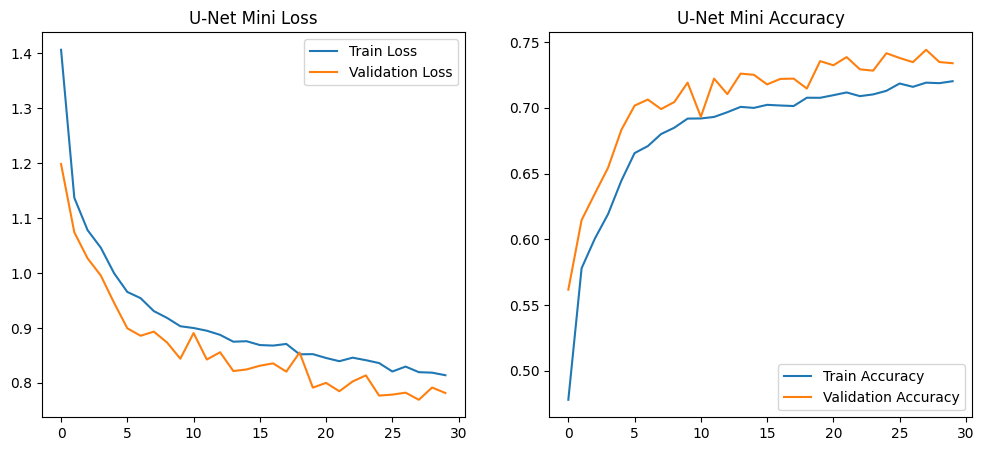

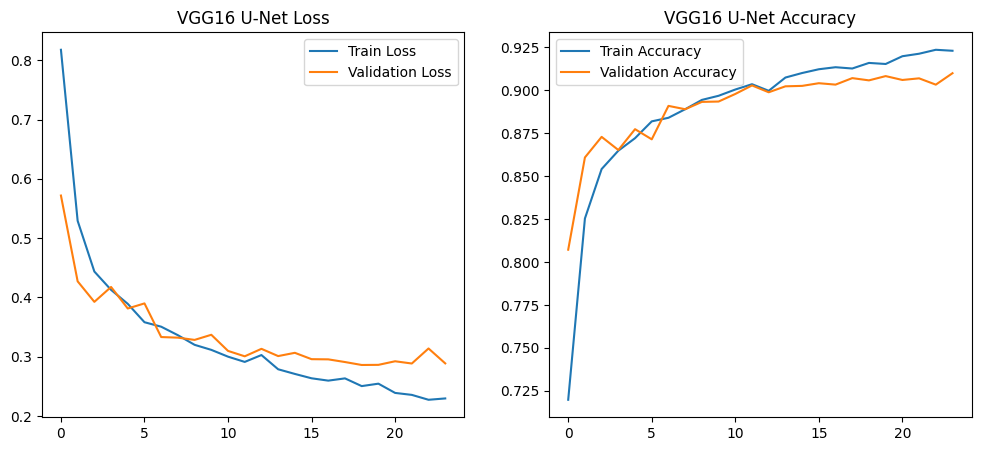

In [ ]:
def plot_training_history(history, model_name):
    plt.figure(figsize=(12, 5))

    plt.subplot(1, 2, 1)
    plt.plot(history.history['loss'], label='Train Loss')
    plt.plot(history.history['val_loss'], label='Validation Loss')
    plt.title(f'{model_name} Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(history.history['accuracy'], label='Train Accuracy')
    plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
    plt.title(f'{model_name} Accuracy')
    plt.legend()

    plt.show()

plot_training_history(history_mini, "U-Net Mini")
plot_training_history(history_vgg16, "VGG16 U-Net")

# 8) Évaluation des modèles sur les données de test

In [ ]:
# Chargement des données de test
test_images, test_masks = load_images_and_masks('/content/drive/My Drive/ColabNotebooks/8.TraiterImagesSysteme/gtFine/test')

Processing city: strasbourg
Processing city: tubingen
Processing city: stuttgart
Total images loaded: 705
Total masks created: 705


In [ ]:
# Création du générateur de test
test_generator = DataGenerator(test_images, test_masks, batch_size=8, img_size=(256, 256), augment=False)

<ipython-input-12-0568b722ac27>:13: UserWarning: Argument(s) 'always_apply' are not valid for transform Resize
  A.Resize(height=self.img_size[0], width=self.img_size[1], always_apply=True)


In [ ]:
# Évaluation du modèle U-Net Mini
print("Évaluation du modèle U-Net Mini:")
test_loss_mini, test_accuracy_mini, test_iou_mini, test_dice_mini = model_mini.evaluate(test_generator)
print(f"Test Loss: {test_loss_mini:.4f}")
print(f"Test Accuracy: {test_accuracy_mini:.4f}")
print(f"Test IoU: {test_iou_mini:.4f}")
print(f"Test Dice Coefficient: {test_dice_mini:.4f}")

Évaluation du modèle U-Net Mini:
15/89 ━━━━━━━━━━━━━━━━━━━━ 0s 8ms/step - accuracy: 0.6963 - loss: 0.8866 - sparse_dice_coef: 0.5603 - sparse_iou: 0.3897

<ipython-input-12-0568b722ac27>:35: UserWarning: Argument(s) 'channel_first' are not valid for transform Resize
  img = A.Resize(height=self.img_size[0], width=self.img_size[1], channel_first=False)(image=img)['image'] # Add channel_first=False
<ipython-input-12-0568b722ac27>:36: UserWarning: Argument(s) 'channel_first' are not valid for transform Resize
  mask = A.Resize(height=self.img_size[0], width=self.img_size[1], channel_first=False)(image=mask)['image'] # Add channel_first=False


89/89 ━━━━━━━━━━━━━━━━━━━━ 1s 16ms/step - accuracy: 0.7119 - loss: 0.8460 - sparse_dice_coef: 0.5767 - sparse_iou: 0.4059
Test Loss: 0.8157
Test Accuracy: 0.7267
Test IoU: 0.4220
Test Dice Coefficient: 0.5926


In [ ]:
# Évaluation du modèle VGG16 U-Net
print("\nÉvaluation du modèle VGG16 U-Net:")
test_loss_vgg16, test_accuracy_vgg16, test_iou_vgg16, test_dice_vgg16 = model_vgg16.evaluate(test_generator)
print(f"Test Loss: {test_loss_vgg16:.4f}")
print(f"Test Accuracy: {test_accuracy_vgg16:.4f}")
print(f"Test IoU: {test_iou_vgg16:.4f}")
print(f"Test Dice Coefficient: {test_dice_vgg16:.4f}")


Évaluation du modèle VGG16 U-Net:
 4/89 ━━━━━━━━━━━━━━━━━━━━ 1s 21ms/step - accuracy: 0.8918 - loss: 0.3772 - sparse_dice_coef: 0.8608 - sparse_iou: 0.7567

<ipython-input-12-0568b722ac27>:35: UserWarning: Argument(s) 'channel_first' are not valid for transform Resize
  img = A.Resize(height=self.img_size[0], width=self.img_size[1], channel_first=False)(image=img)['image'] # Add channel_first=False
<ipython-input-12-0568b722ac27>:36: UserWarning: Argument(s) 'channel_first' are not valid for transform Resize
  mask = A.Resize(height=self.img_size[0], width=self.img_size[1], channel_first=False)(image=mask)['image'] # Add channel_first=False


89/89 ━━━━━━━━━━━━━━━━━━━━ 3s 36ms/step - accuracy: 0.8990 - loss: 0.3209 - sparse_dice_coef: 0.8650 - sparse_iou: 0.7630
Test Loss: 0.3001
Test Accuracy: 0.9052
Test IoU: 0.7747
Test Dice Coefficient: 0.8724


In [ ]:
# Fonction pour générer des prédictions
def generate_predictions(model, generator, num_samples=5):
    for i in range(num_samples):
        batch_images, batch_masks = generator[i]
        predictions = model.predict(batch_images)

        for j in range(len(batch_images)):
            plt.figure(figsize=(15, 5))

            plt.subplot(1, 3, 1)
            plt.title("Image originale")
            plt.imshow(batch_images[j])
            plt.axis('off')

            plt.subplot(1, 3, 2)
            plt.title("Masque réel")
            plt.imshow(batch_masks[j], cmap='jet')
            plt.axis('off')

            plt.subplot(1, 3, 3)
            plt.title("Prédiction")
            plt.imshow(np.argmax(predictions[j], axis=-1), cmap='jet')
            plt.axis('off')

            plt.show()

Prédictions du modèle U-Net Mini:


<ipython-input-12-0568b722ac27>:35: UserWarning: Argument(s) 'channel_first' are not valid for transform Resize
  img = A.Resize(height=self.img_size[0], width=self.img_size[1], channel_first=False)(image=img)['image'] # Add channel_first=False
<ipython-input-12-0568b722ac27>:36: UserWarning: Argument(s) 'channel_first' are not valid for transform Resize
  mask = A.Resize(height=self.img_size[0], width=self.img_size[1], channel_first=False)(image=mask)['image'] # Add channel_first=False


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 542ms/step


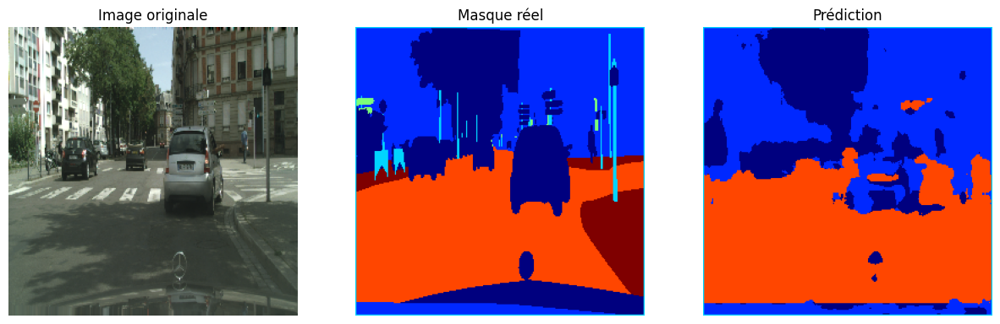

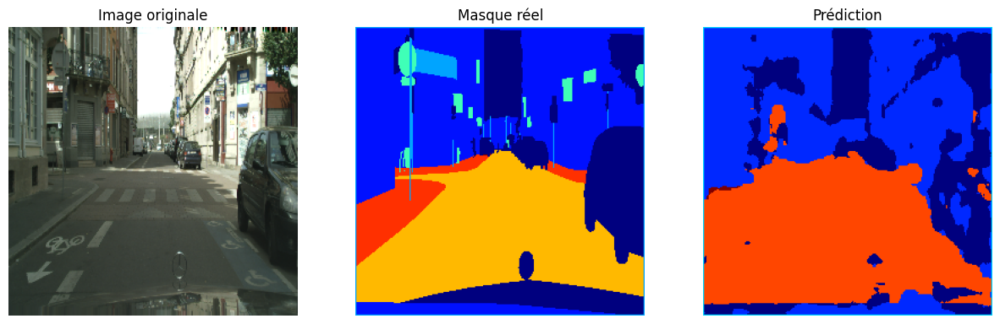

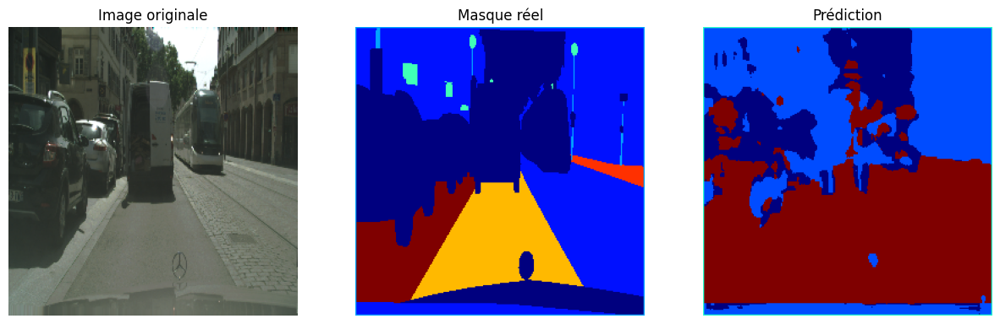

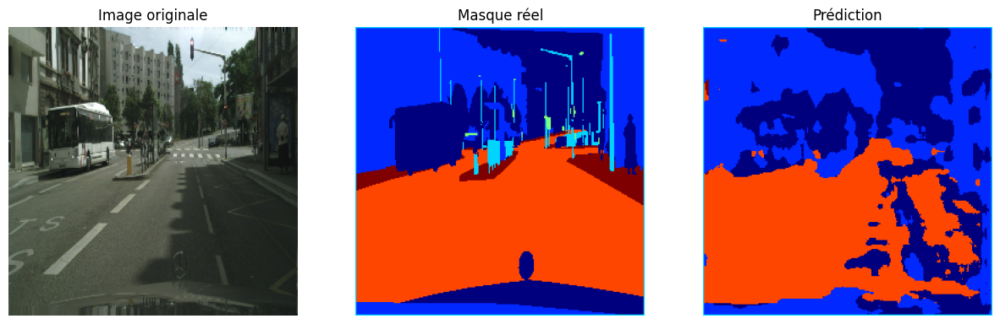

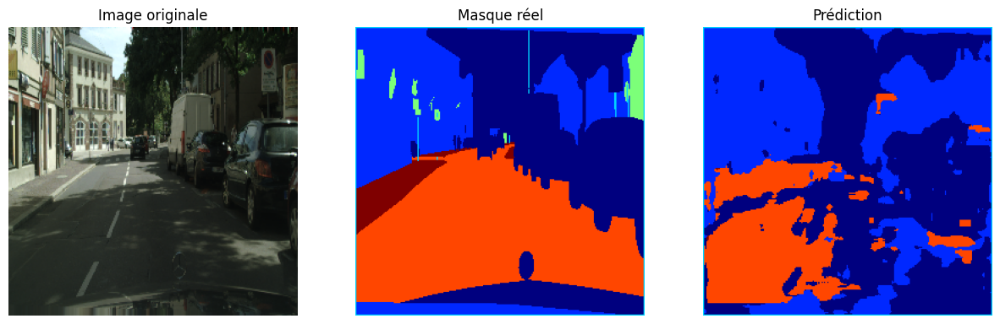

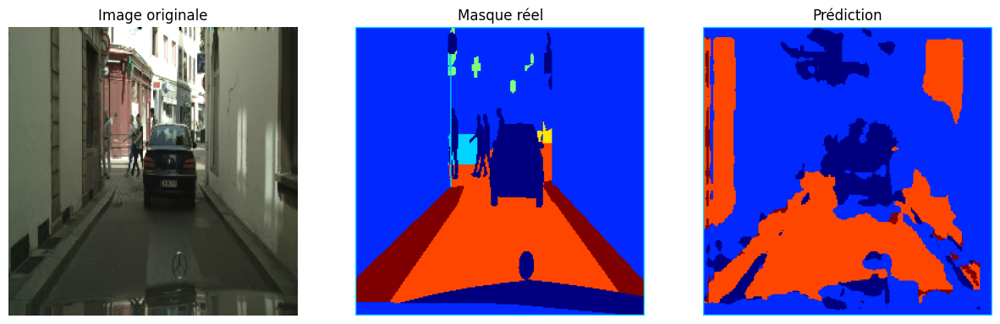

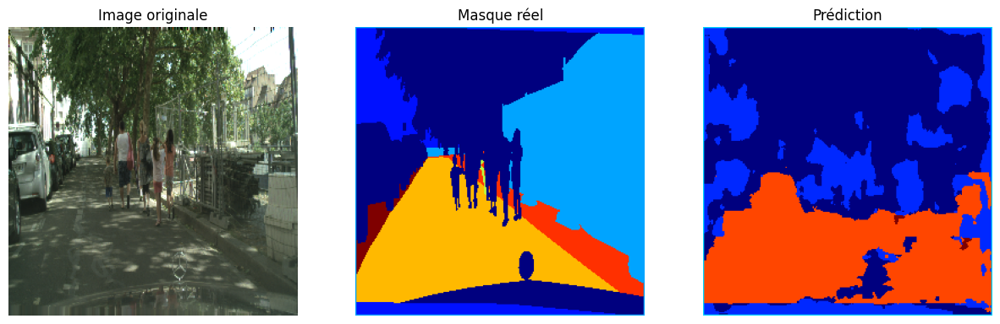

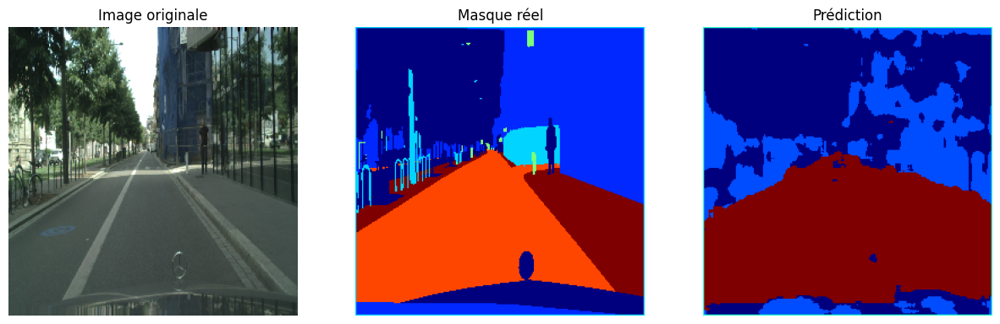

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step


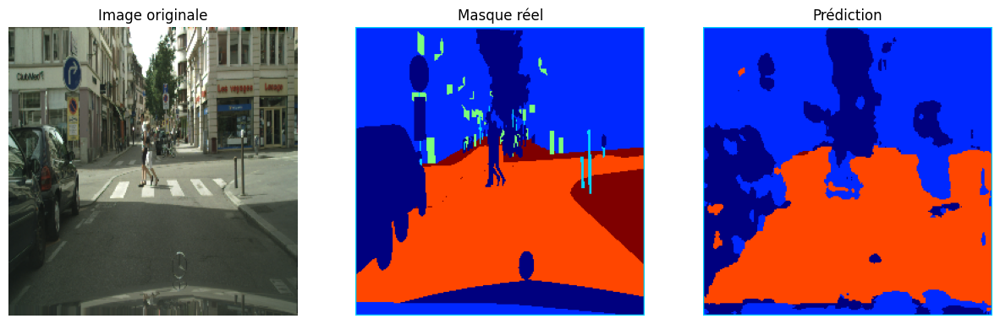

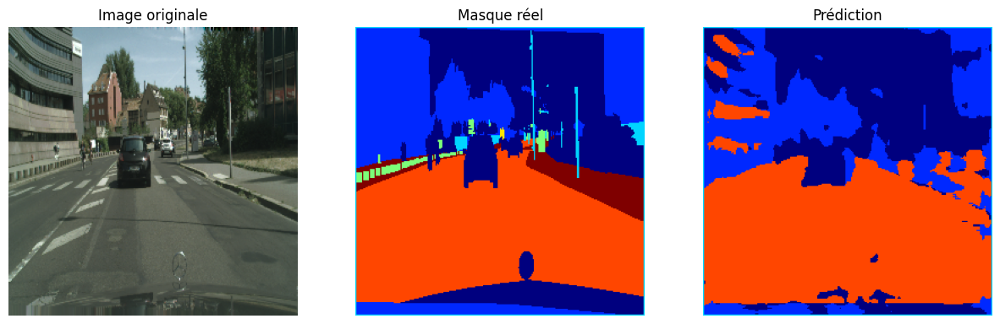

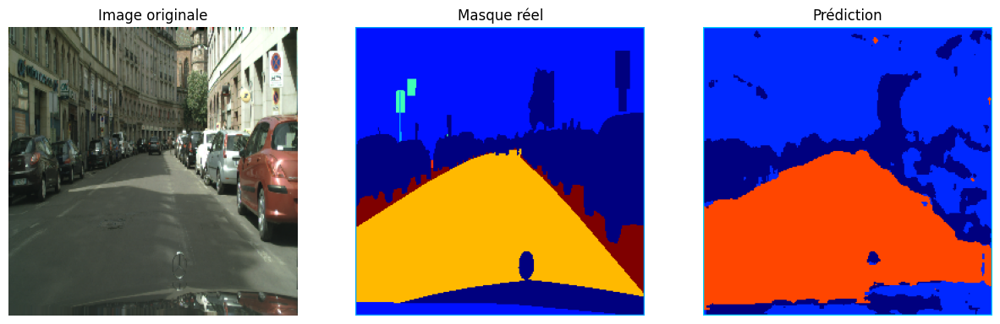

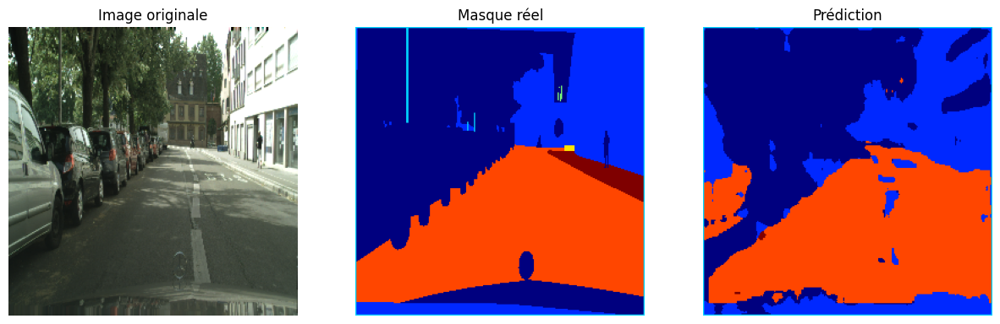

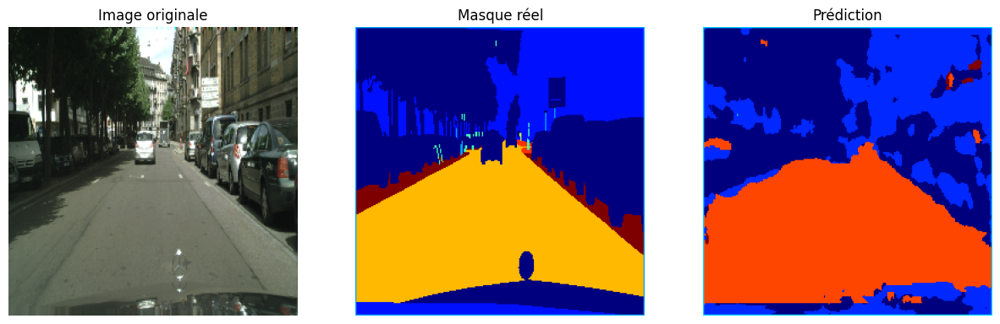

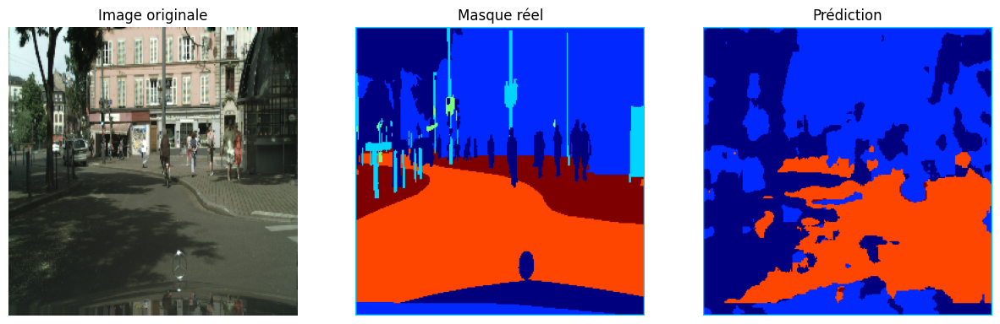

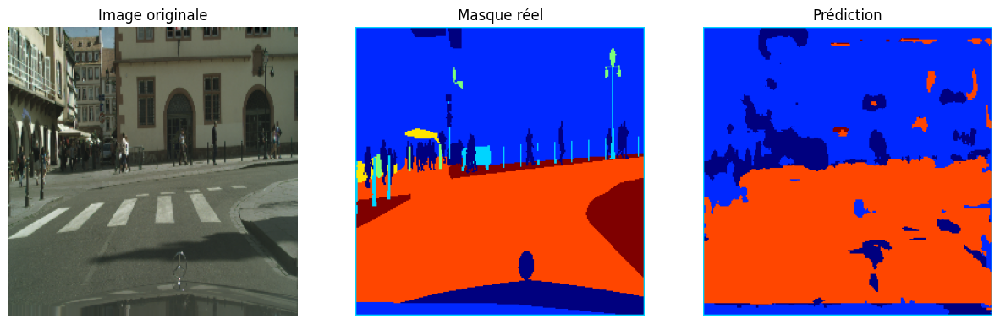

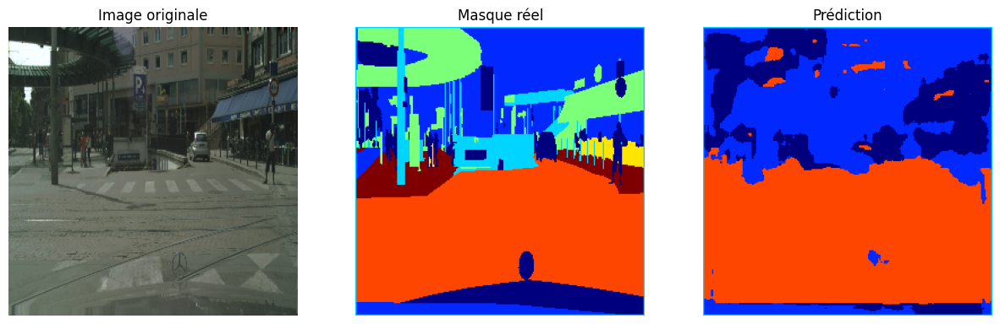

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step


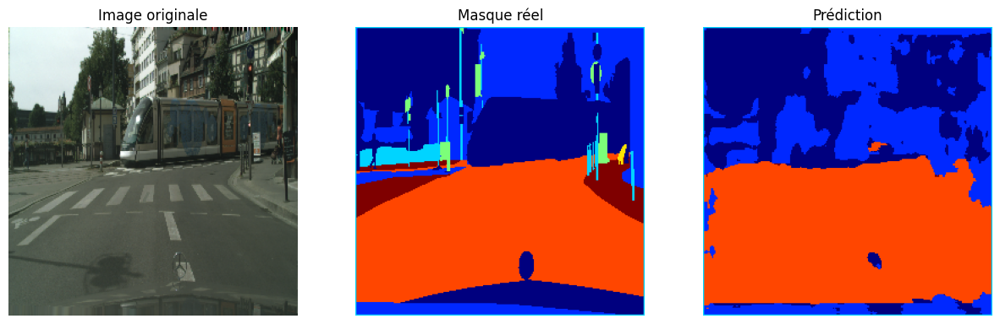

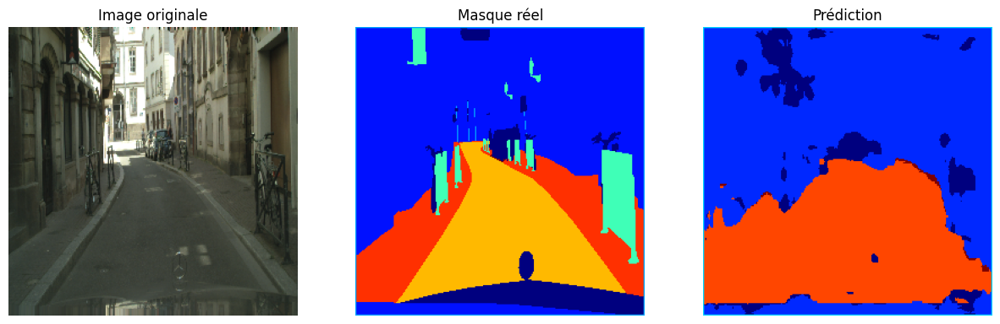

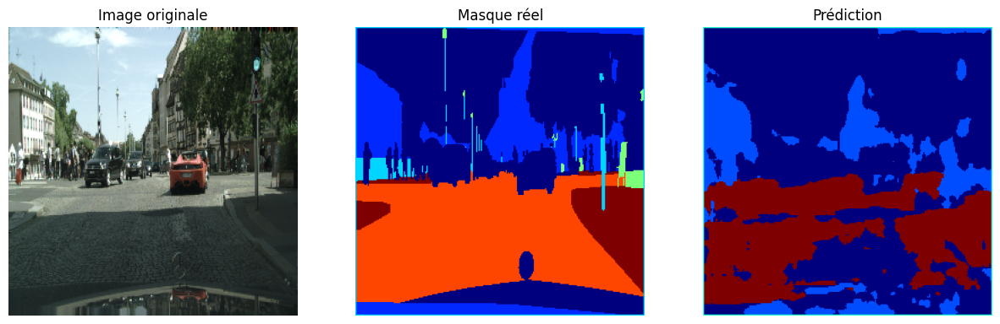

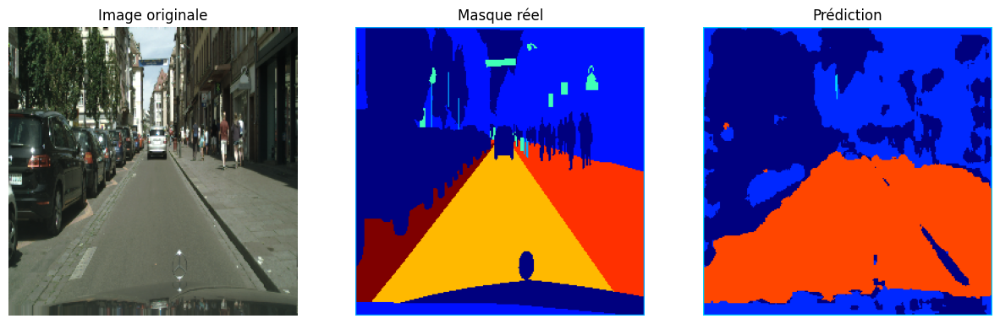

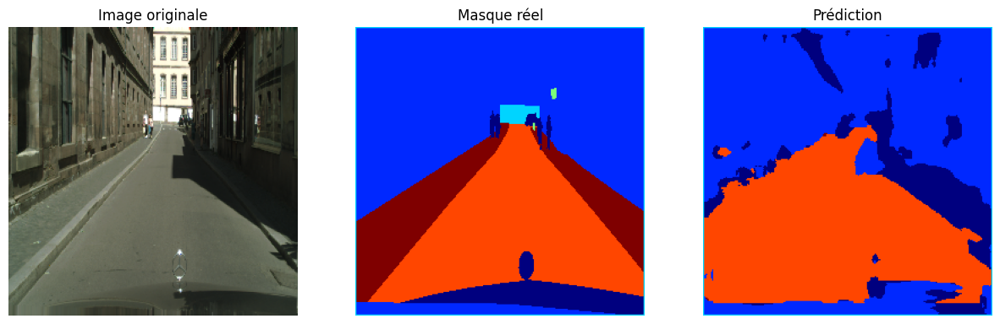

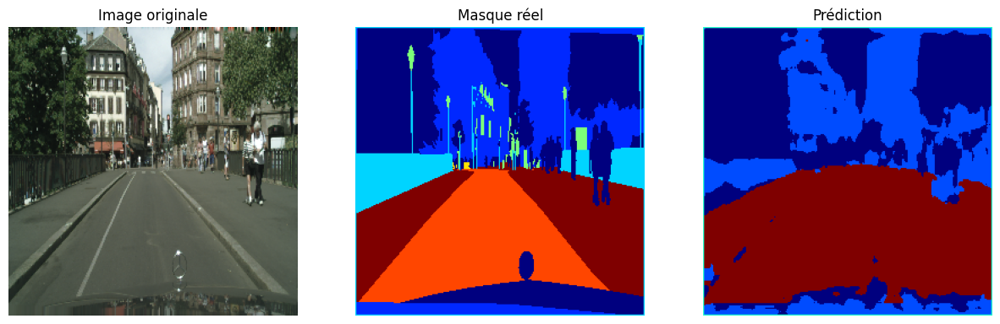

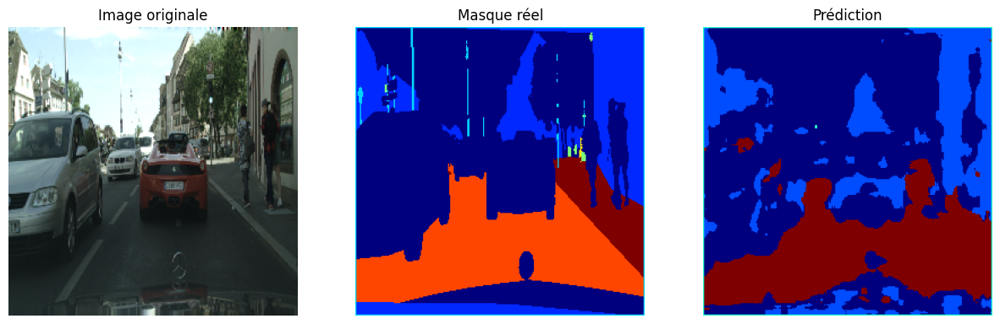

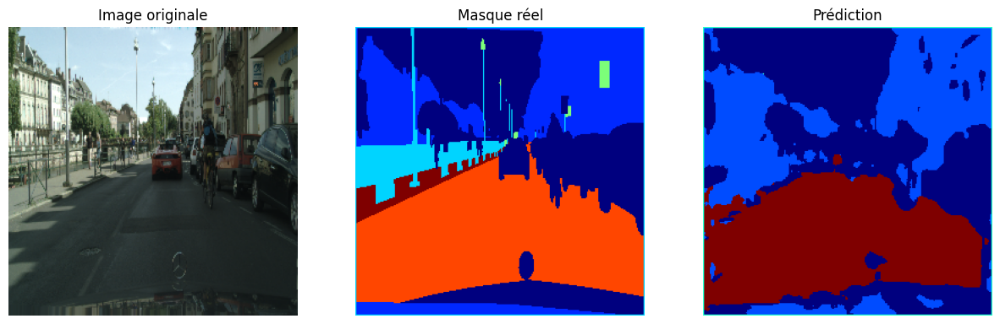

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


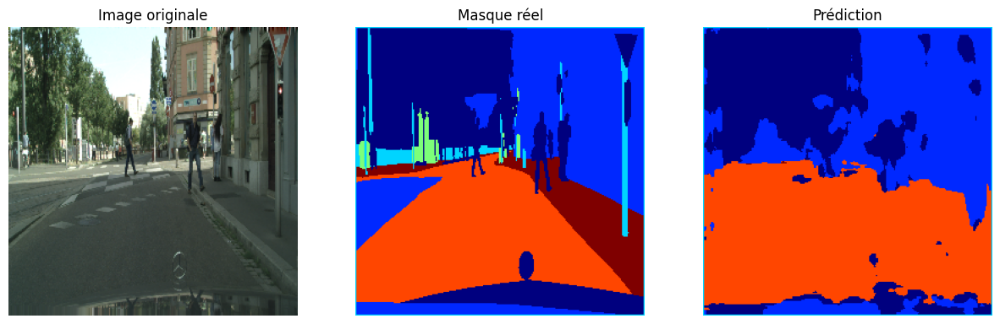

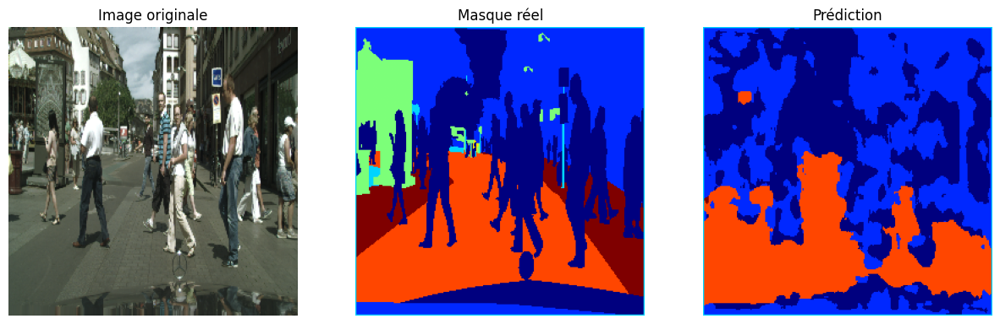

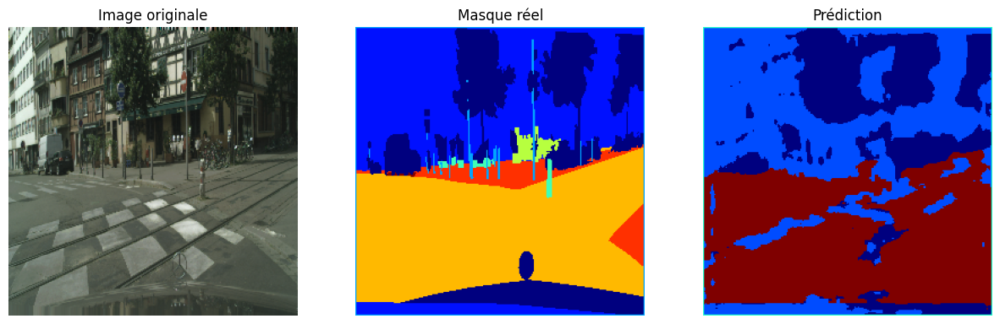

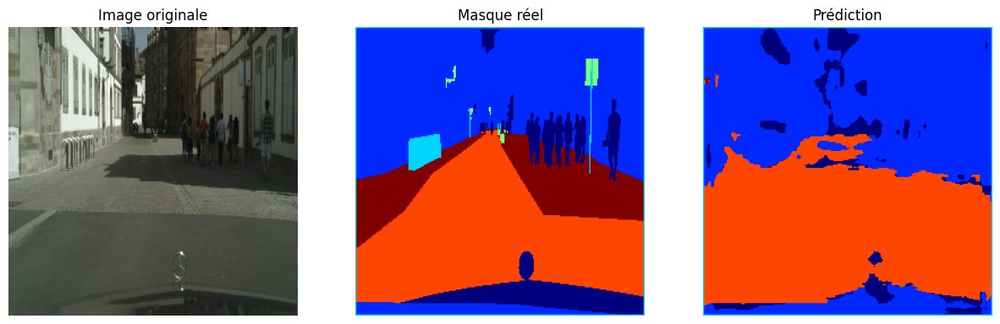

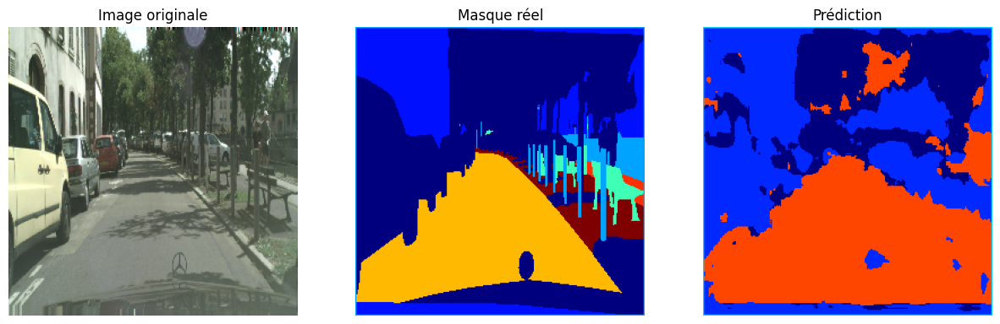

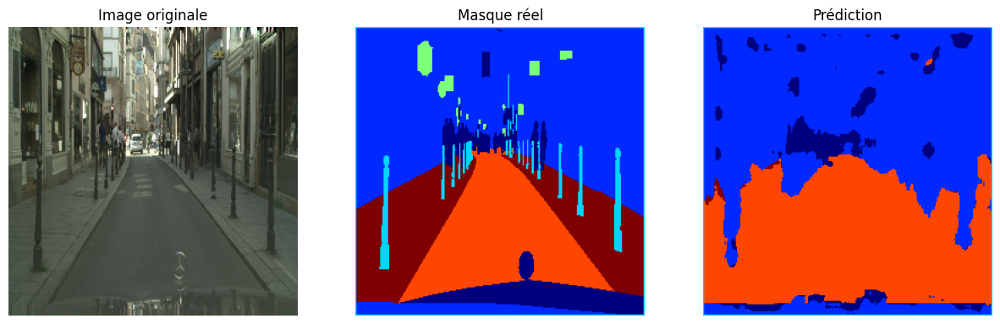

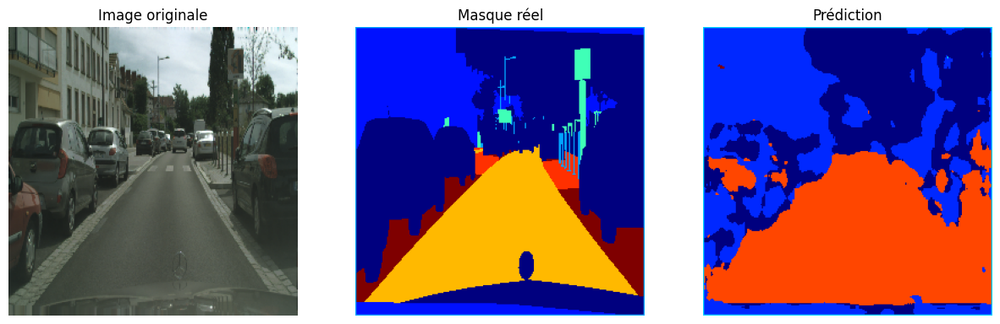

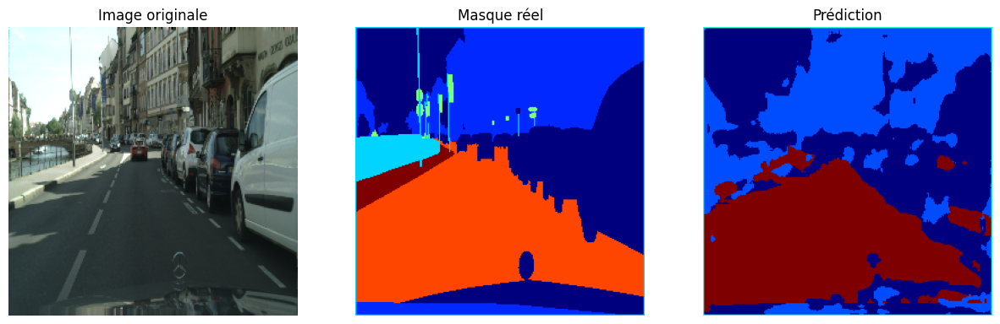

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step


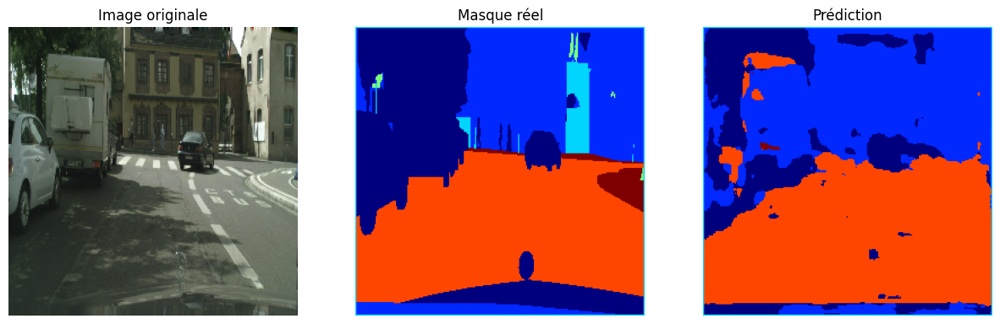

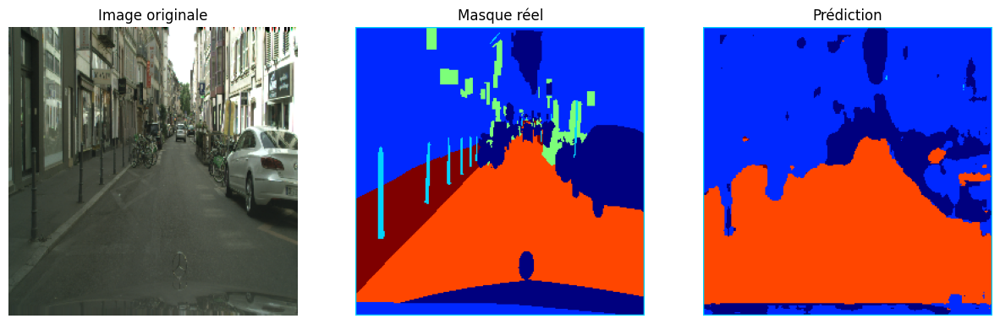

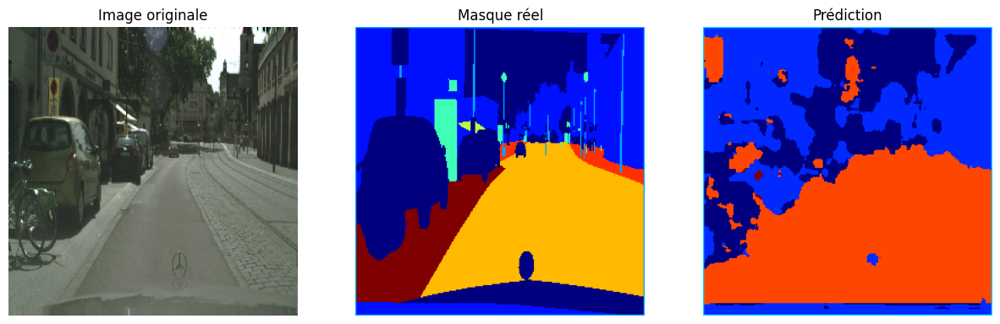

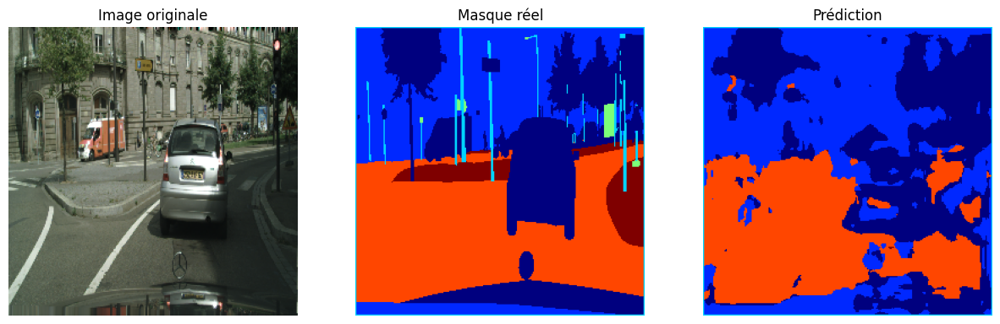

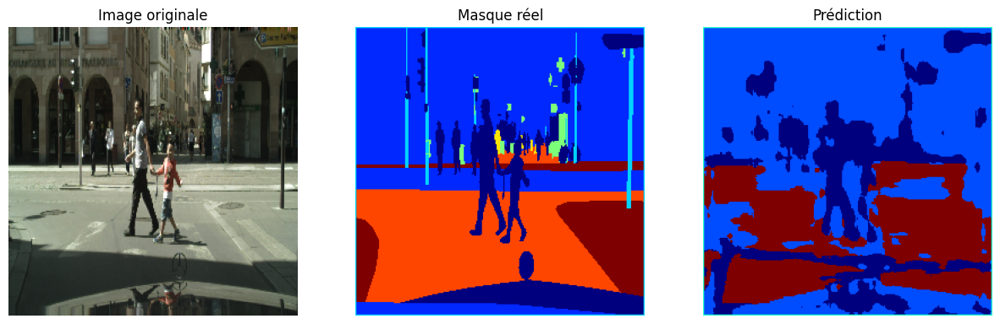

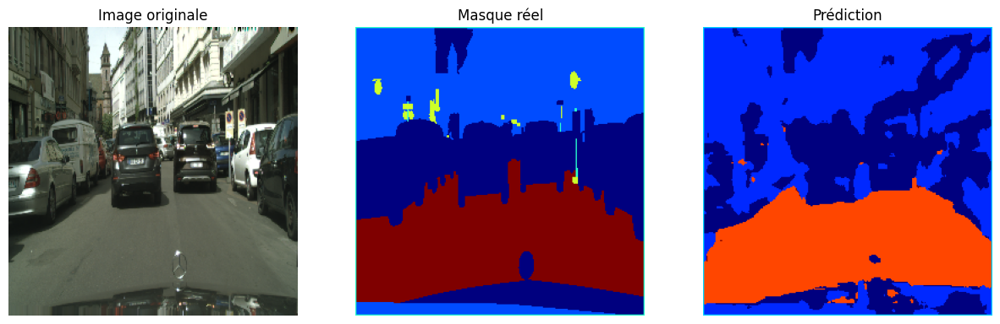

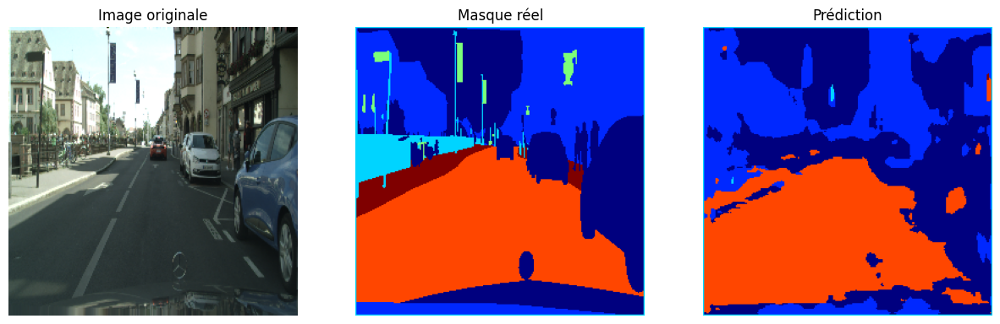

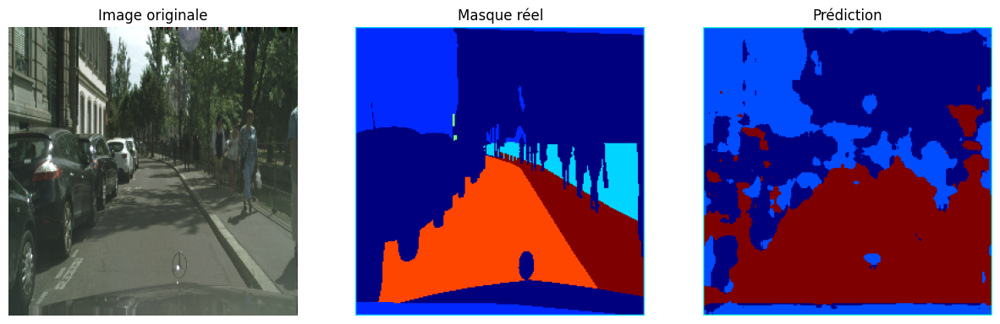

In [ ]:
# Générer des prédictions pour le modèle U-Net Mini
print("Prédictions du modèle U-Net Mini:")
generate_predictions(model_mini, test_generator)


Prédictions du modèle VGG16 U-Net:


<ipython-input-12-0568b722ac27>:35: UserWarning: Argument(s) 'channel_first' are not valid for transform Resize
  img = A.Resize(height=self.img_size[0], width=self.img_size[1], channel_first=False)(image=img)['image'] # Add channel_first=False
<ipython-input-12-0568b722ac27>:36: UserWarning: Argument(s) 'channel_first' are not valid for transform Resize
  mask = A.Resize(height=self.img_size[0], width=self.img_size[1], channel_first=False)(image=mask)['image'] # Add channel_first=False
/usr/local/lib/python3.11/dist-packages/keras/src/models/functional.py:237: UserWarning: The structure of `inputs` doesn't match the expected structure.
Expected: ['keras_tensor_65']
Received: inputs=Tensor(shape=(8, 256, 256, 3))
  warnings.warn(msg)


1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 946ms/step


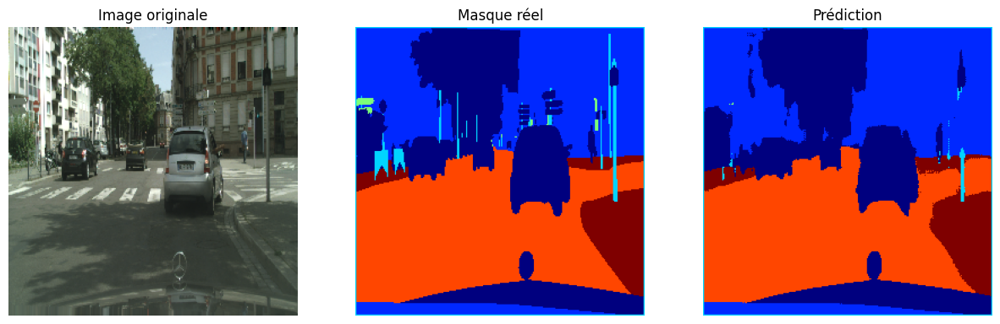

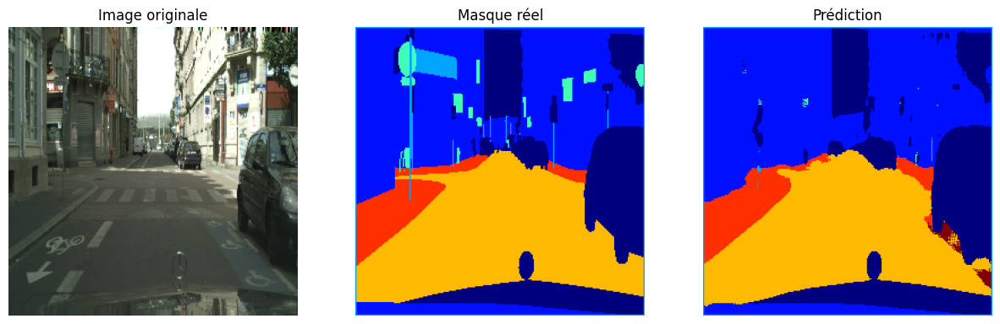

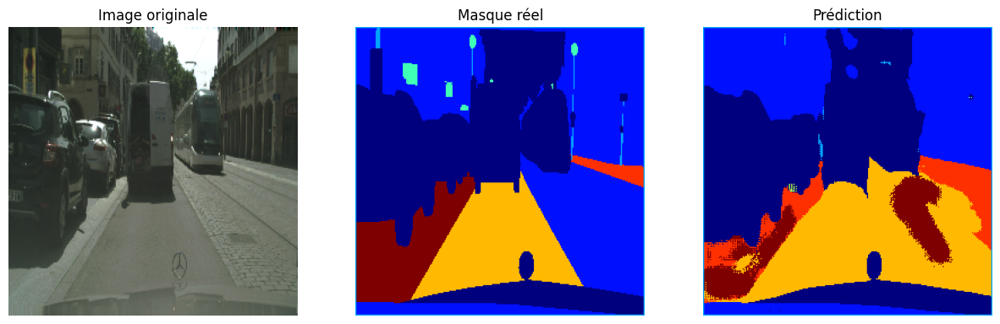

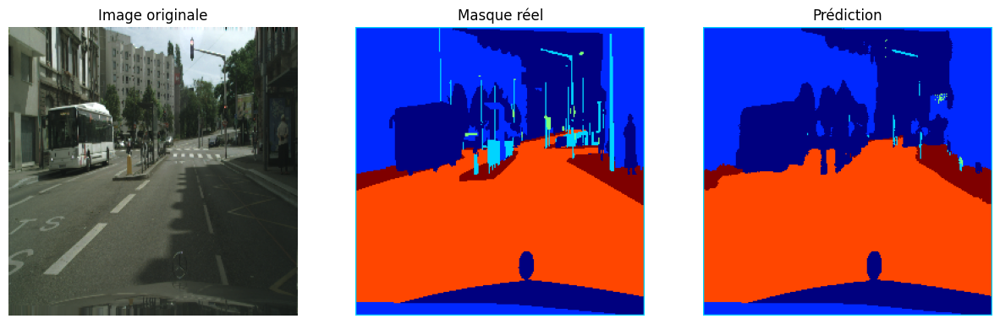

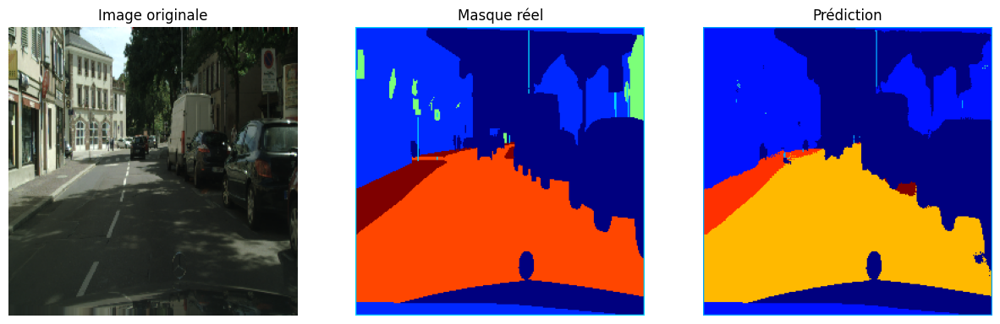

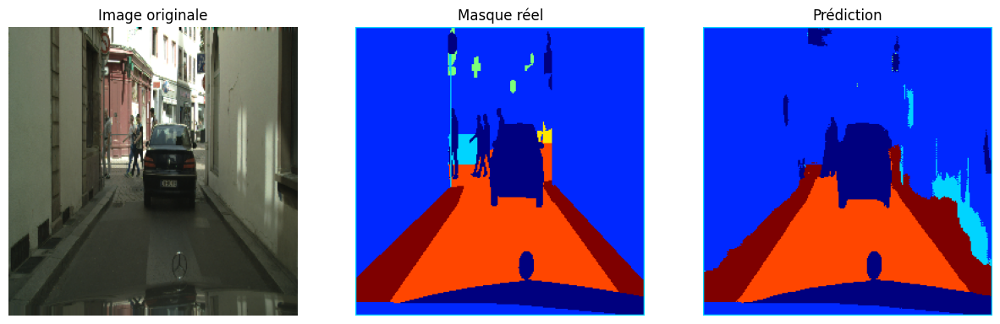

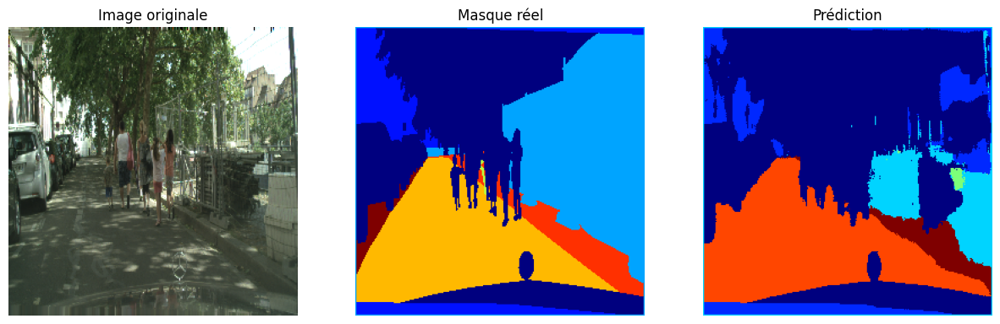

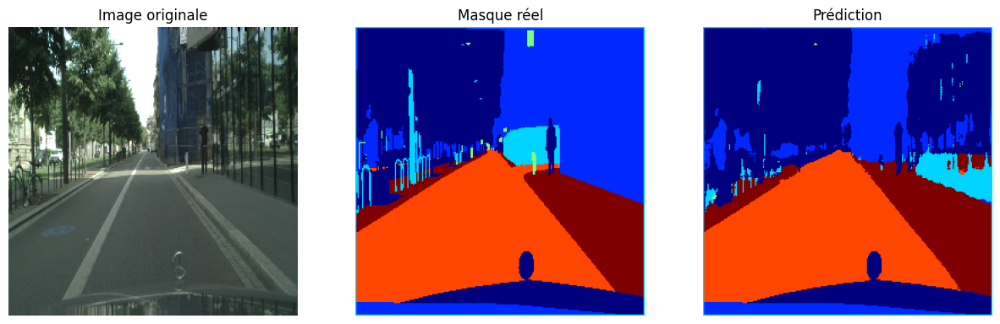

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step


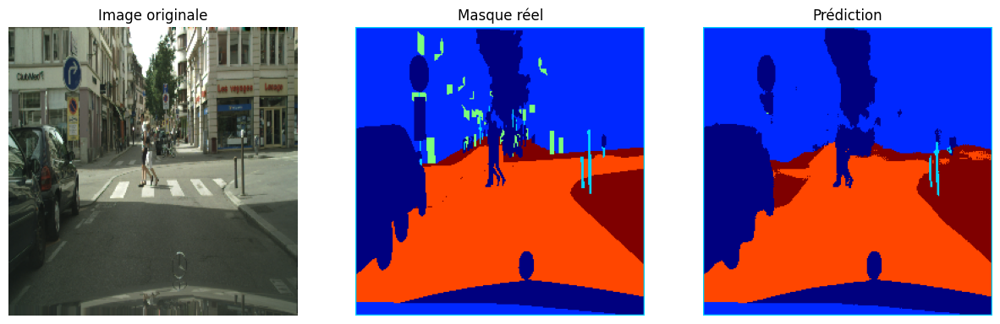

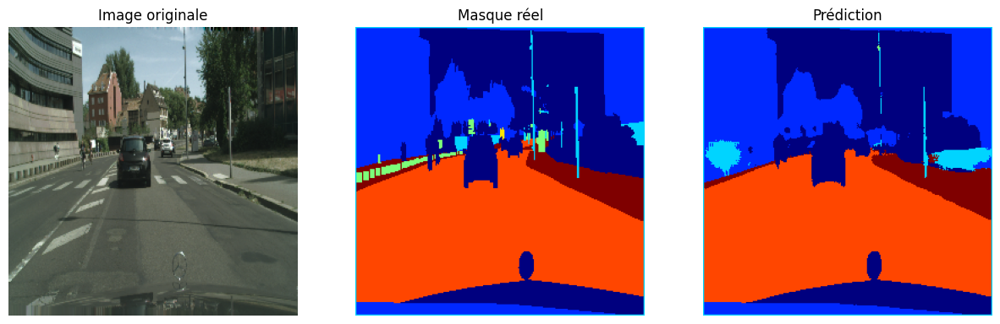

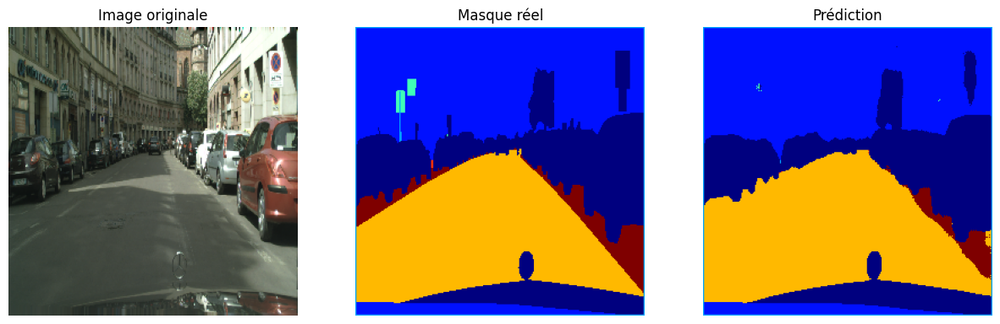

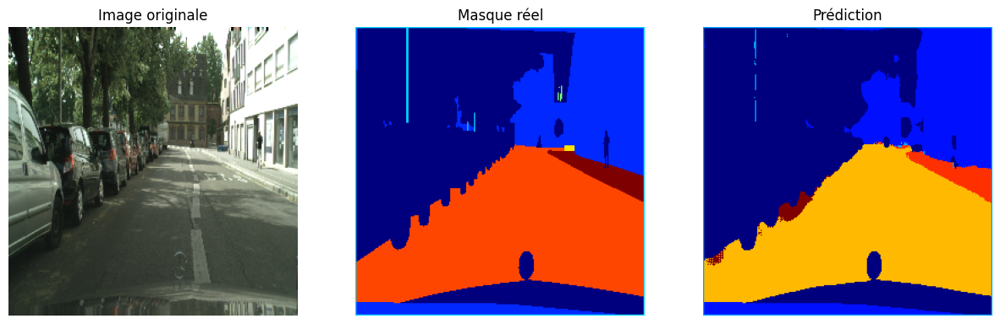

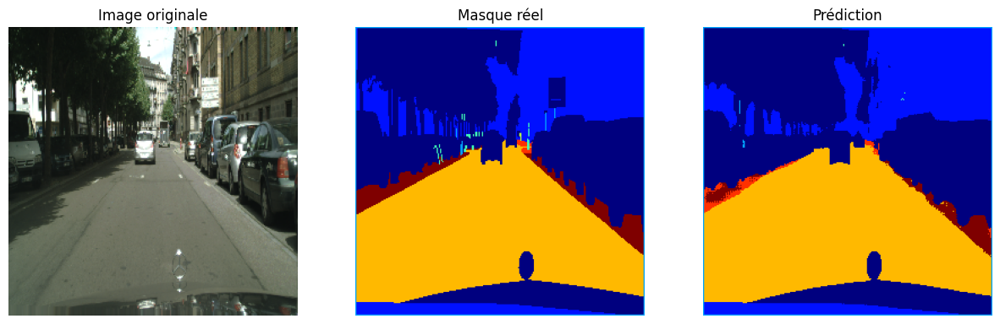

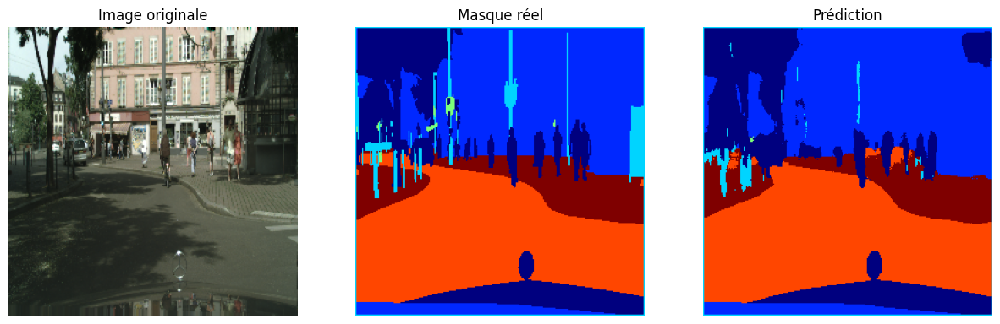

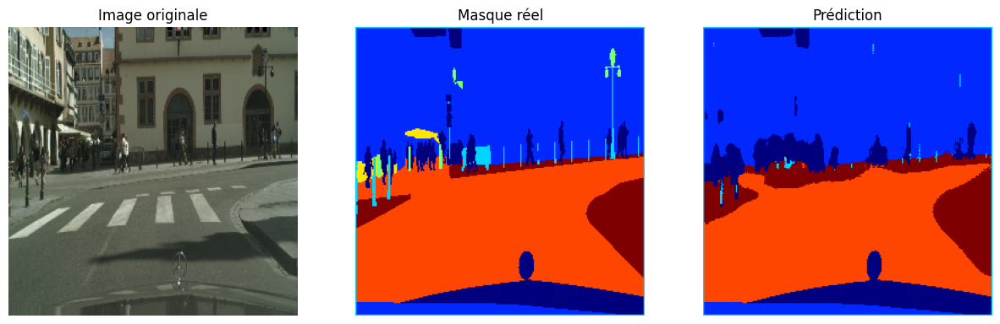

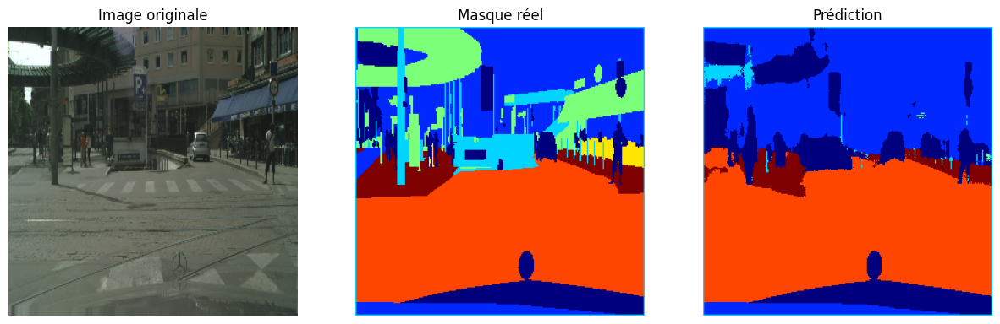

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


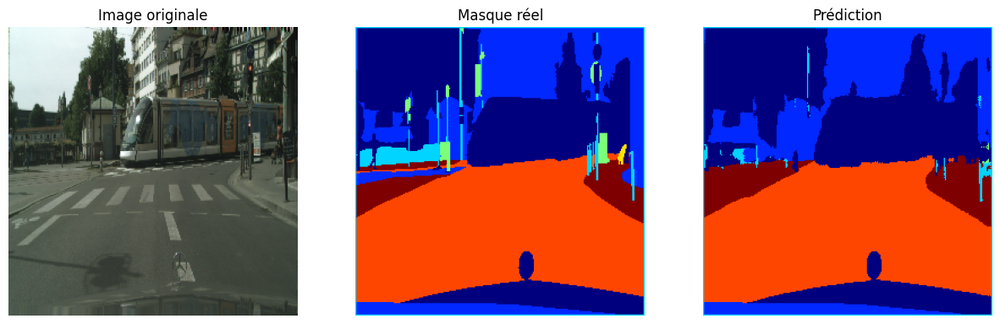

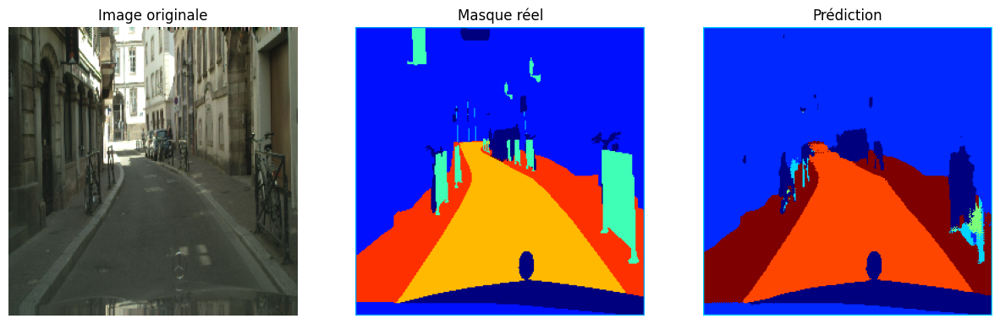

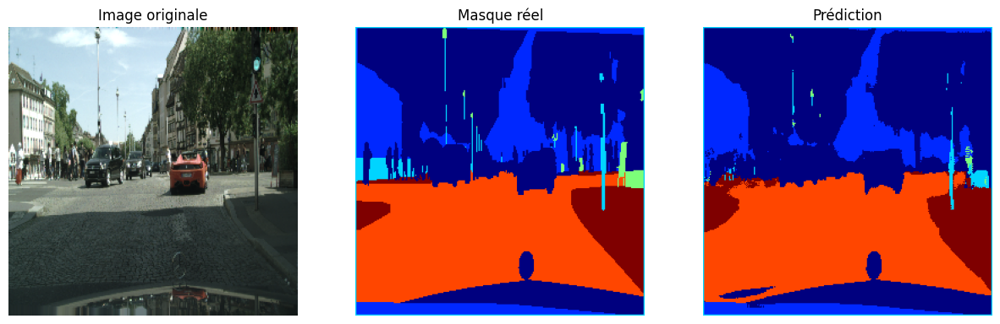

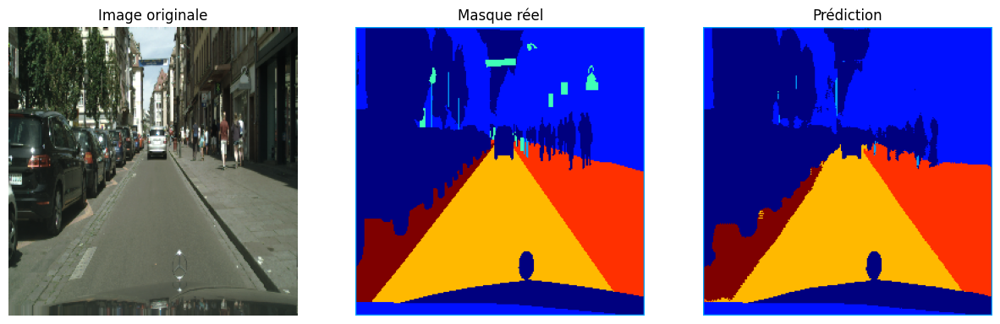

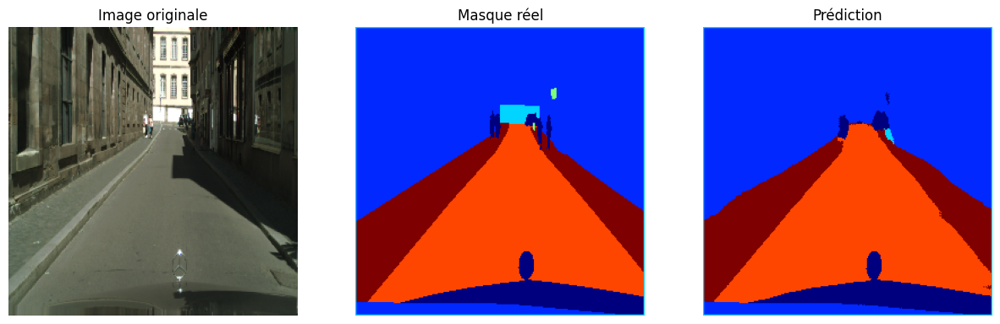

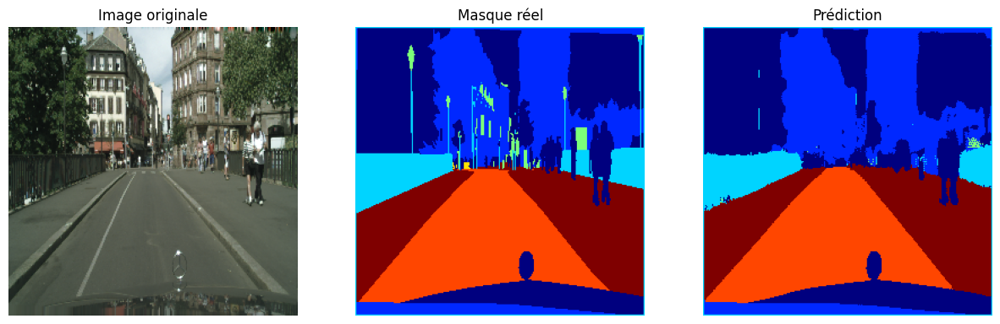

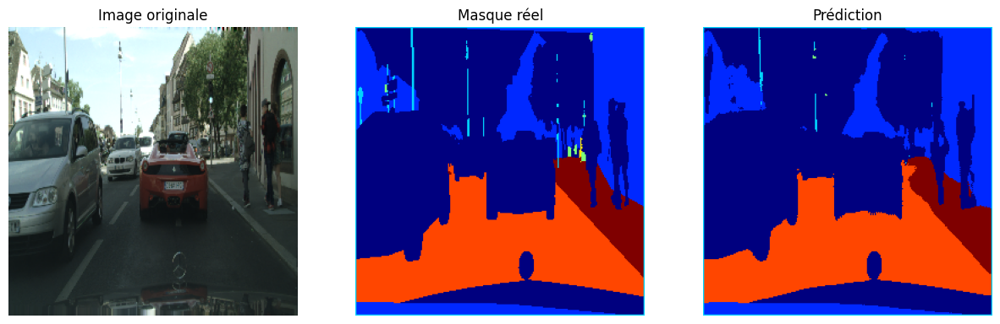

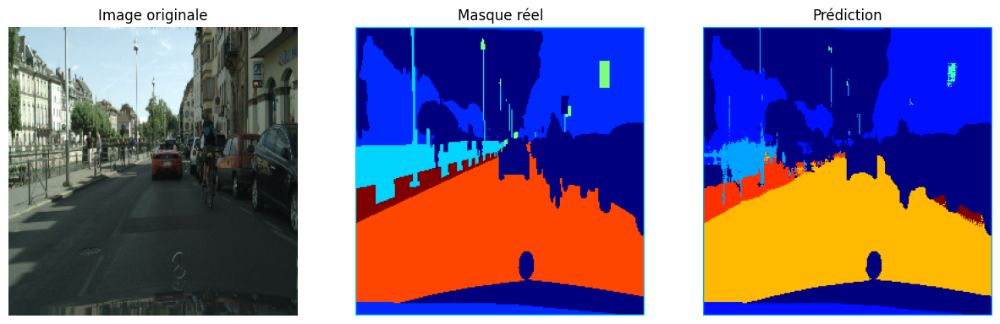

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step


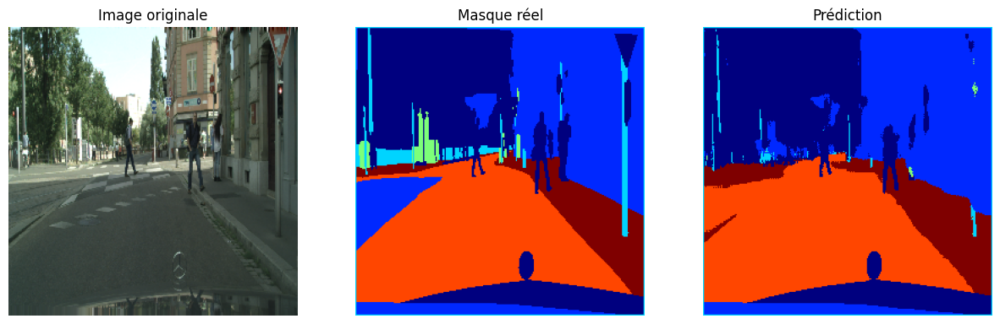

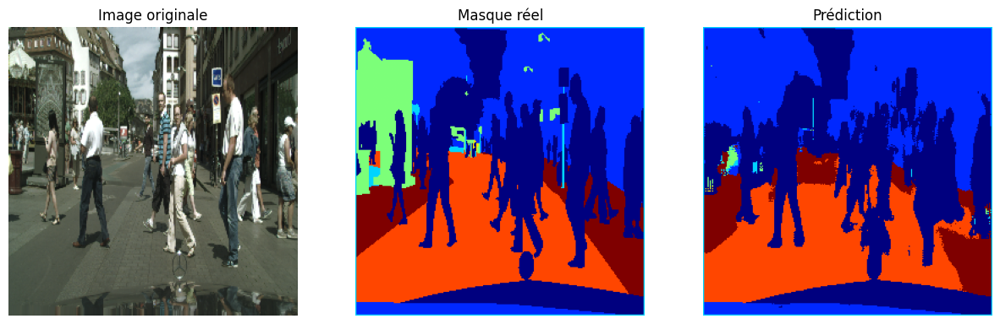

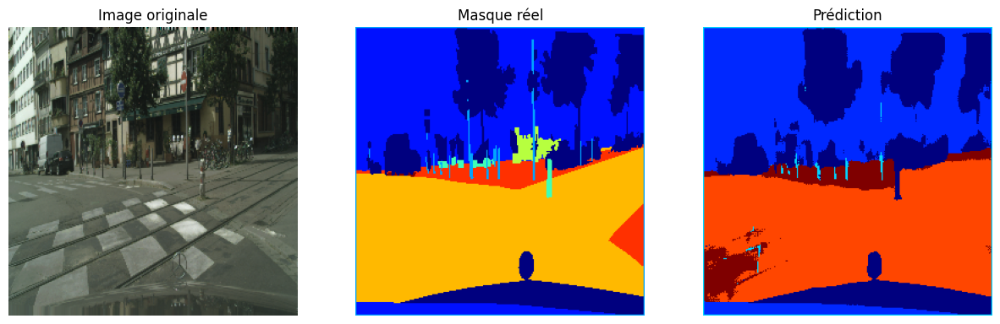

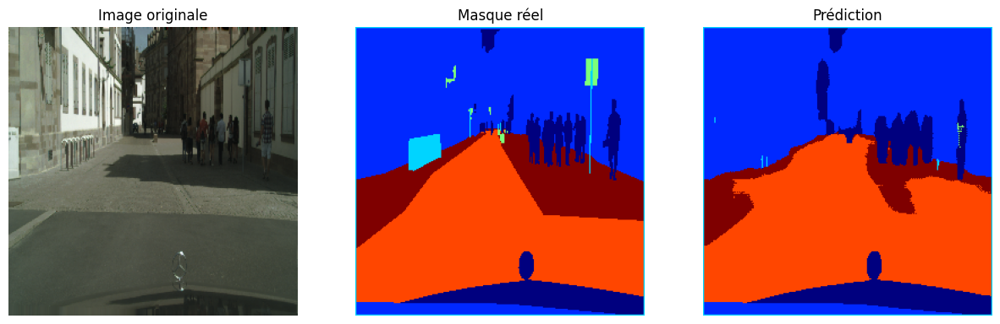

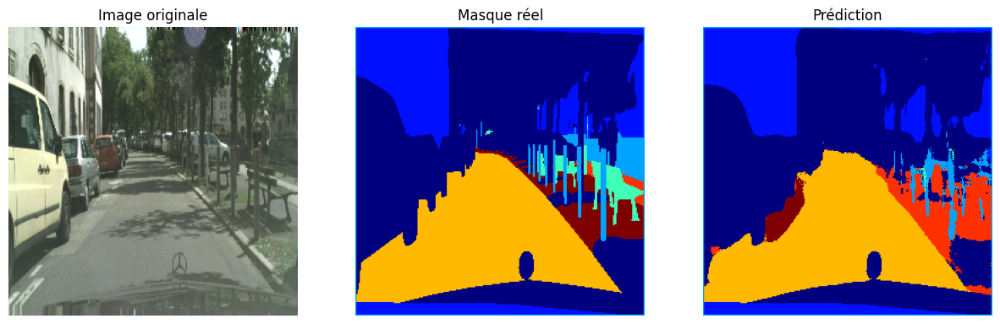

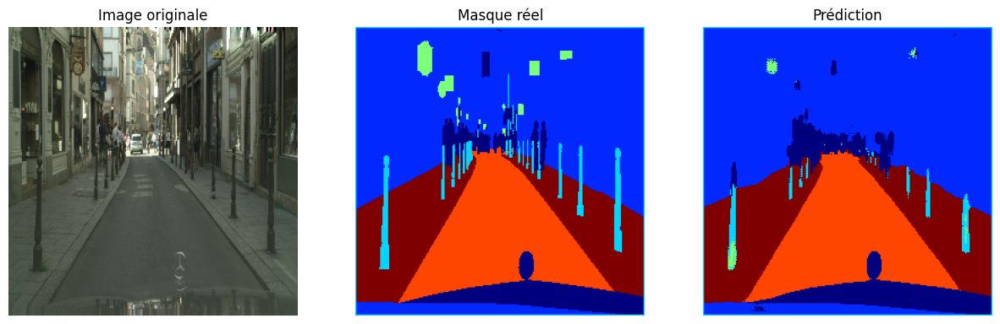

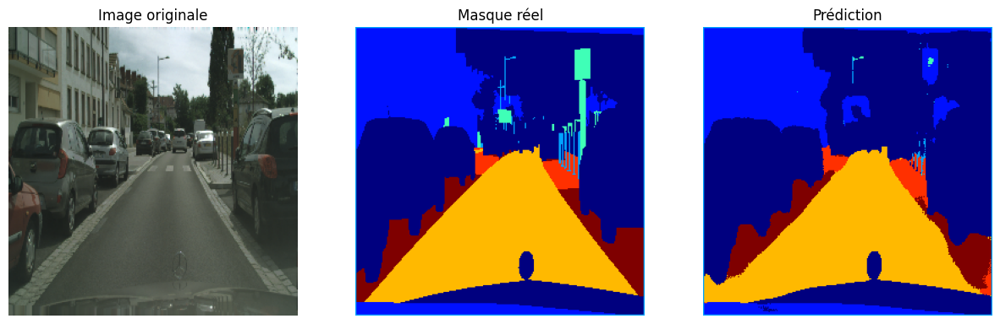

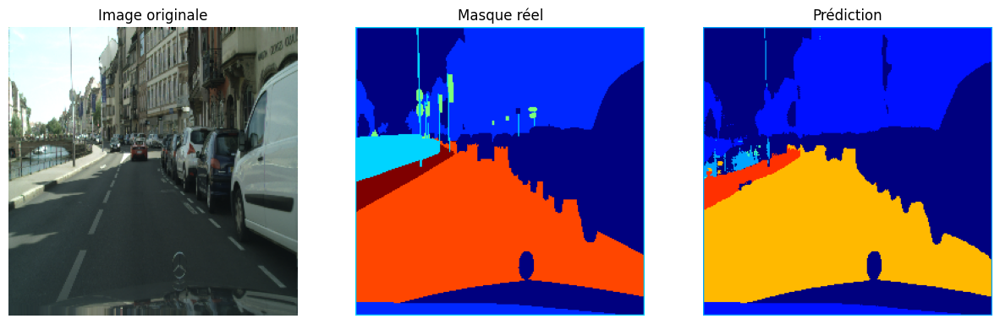

1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 55ms/step


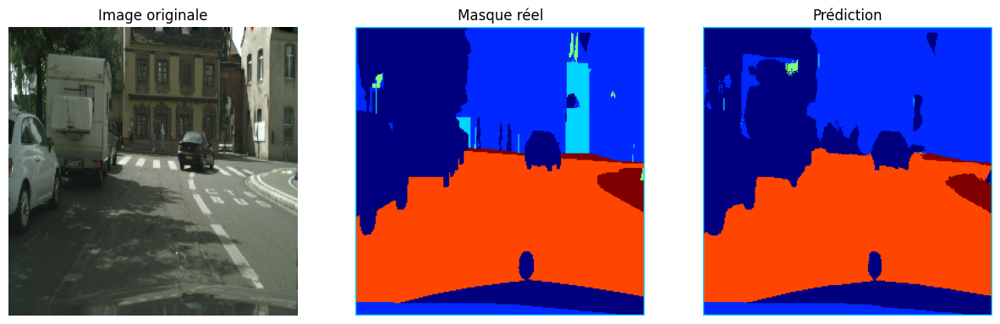

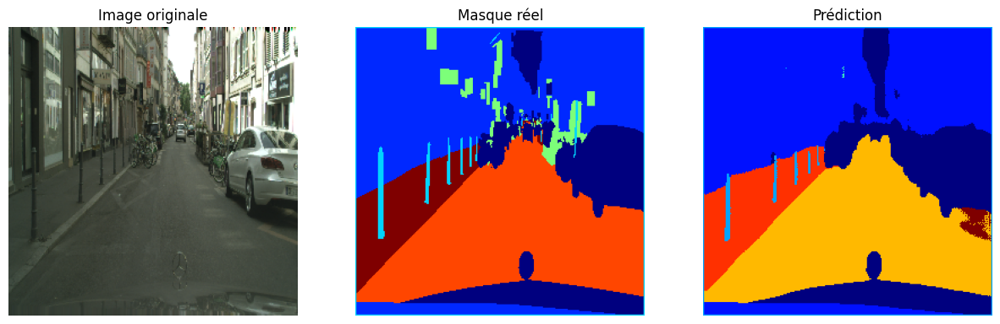

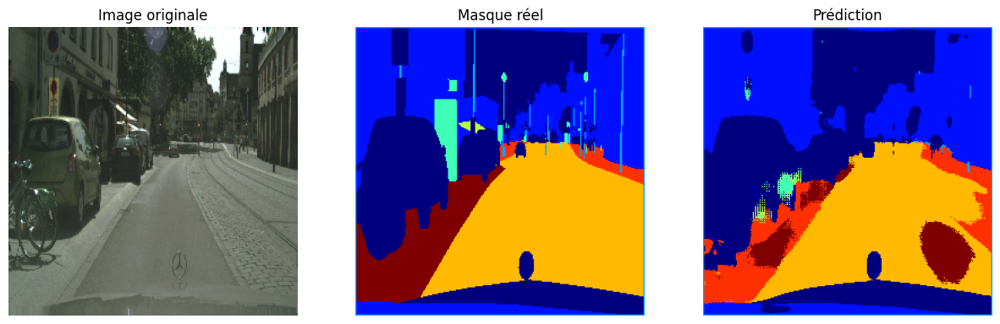

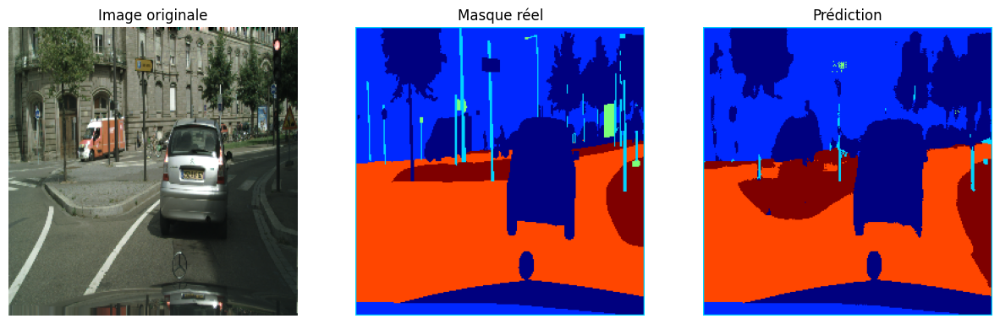

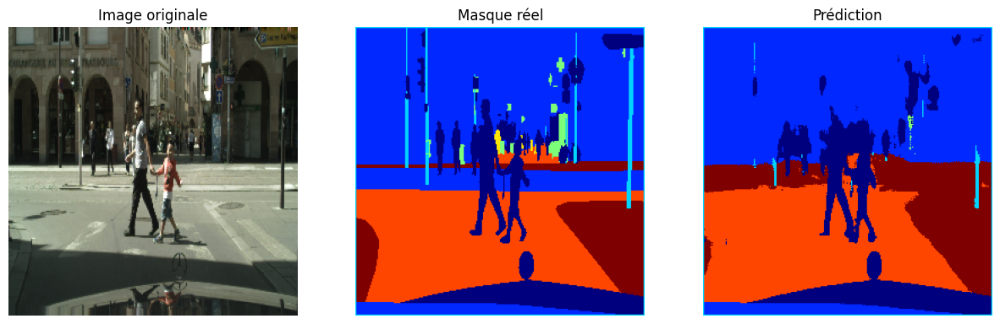

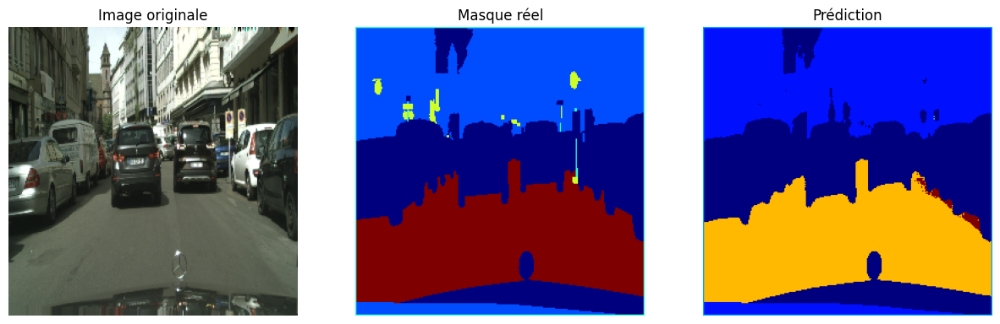

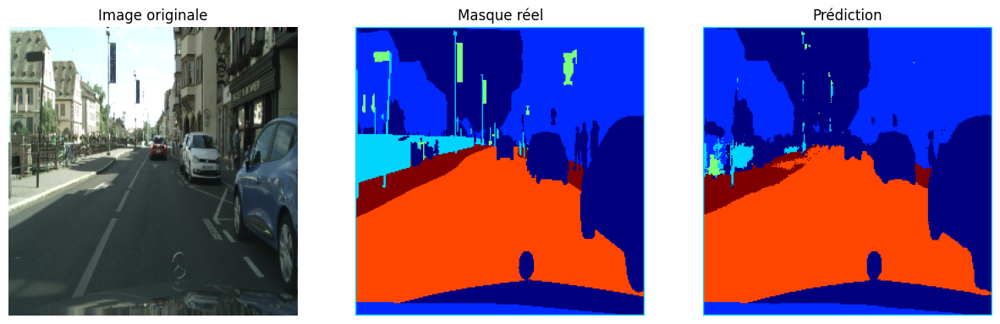

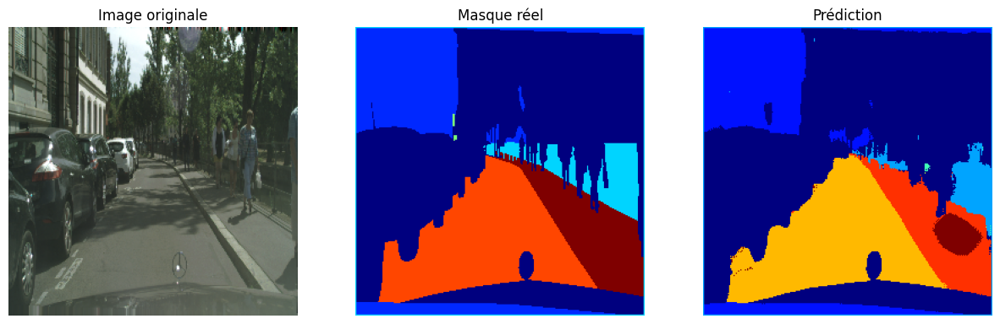

In [ ]:
# Générer des prédictions pour le modèle VGG16 U-Net
print("Prédictions du modèle VGG16 U-Net:")
generate_predictions(model_vgg16, test_generator)